In [1]:
#this cell is just for google colab
#from google.colab import drive
# Monta la carpeta en Google Colab
#drive.mount('/content/drive')
#%cd "/content/drive/MyDrive/Spectral Time Series - Ramirez M"

In [2]:
#if you are not in colab run this cell
import os
os.chdir('..')
#this is to move to the directory /Spectral Time Series - Ramirez M


In [3]:
%run "Codes/Funciones_colab.ipynb"

C:\Users\mrami\anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.25.2
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# 2- OT Combinations


The present notebook serves to illustrate the methodology for computing an interpolated grid of spectra using Optimal Transport for each supernova (SN) in the dataset. It is noteworthy that all possible combinations between pairs of spectra for a given SN are explored, resulting in a series of spectra that lie between them. This approach is intended to facilitate the generation of a weighted mean spectral time series.

## Creating Functions

In [8]:

def OT_grid_1MJD(ESPECTRO,fases,name,plot=False):

    OT_all=[]
    fase_all=[]
    fig_all=[]
    ini_all=[]
    fin_all=[]
    cercania_all=[]

    arr = fases
    r = 2
    import itertools
    combinations=list(itertools.combinations(fases, r))

    #print(combinations)
    for j in range(len(combinations)):
        ini=combinations[j][0]
        fin=combinations[j][1]

        print('Interpolation between dates:',ini,fin)

        delta_days=np.abs(int(fin)-int(ini))
        if delta_days>50:
            print('WARNING: "Delta days exceeding 50 warrants skipping interpolation to ensure accurate time series analysis.":',delta_days)
            continue

        pos_fase_ini=fases.index(ini)
        pos_fase_fin=fases.index(fin)
        spec1_df=pd.DataFrame(ESPECTRO[pos_fase_ini],dtype='float64').copy()
        #spec1_df.drop(1,axis='columns', inplace=True) #esto es solo para las que vienen con 3 columnas del MAD
        spec1_df.columns=['wave','flux']
        #spec1_df
        spec2_df=pd.DataFrame(ESPECTRO[pos_fase_fin],dtype='float64').copy()
        #esto es solo para las que vienen con 3 columnas del MAD
        #spec2_df.drop(1,axis='columns', inplace=True)
        spec2_df.columns=['wave','flux']
        #spec2_df.head()

        #Pre process for a better interpolation, avoid negative values and then normalize for the maximum value
        #we compute the mean value of the fluxes of spectra, to use as cte to reescal
        fluxes=[]
        for i in range(len(ESPECTRO)):
            fluxes=np.concatenate((fluxes, ESPECTRO[i].flux.to_numpy()), axis=None)
        cte_flux=np.median(fluxes)

        cte_sum_spec1=np.min(spec1_df['flux'])
        cte_sum_spec2=np.min(spec2_df['flux'])
        cte_sum_general=np.abs(np.min([cte_sum_spec1,cte_sum_spec2])) #me saco los negativos
        #cte_norm_spec1=np.max(spec1_df['flux'])
        #cte_norm_spec2=np.max(spec2_df['flux'])

        spec1_df['flux']=spec1_df['flux']+cte_sum_general
        #spec1_df['flux']=spec1_df['flux']/cte_norm_spec1

        spec2_df['flux']=spec2_df['flux']+cte_sum_general
        #spec2_df['flux']=spec2_df['flux']/cte_norm_spec2

        spec1_df['flux']=spec1_df['flux']/cte_flux
        spec2_df['flux']=spec2_df['flux']/cte_flux

        s1 = pd.merge(spec1_df, spec2_df, how='inner', on=['wave'])

        #revizamos que haya interseccion si no nos saltamos al sgt:
        if len(s1)==0:
            print('EMPTY DATA FRAME, INTERSECTION BETWEEN SPECTRA DONT EXIST, CANNOT PRODUCE OT')
            continue
        #print(spec1_df)
        #print(spec2_df)
        if plot==True:
            fig= plt.figure(figsize=(12, 5))
            ax  = fig.add_subplot(111)
            ax.tick_params('both', length=6, width=1, which='major', direction='in')
            ax.tick_params('both', length=3, width=1, which='minor', direction='in')
            ax.xaxis.set_ticks_position('both')
            ax.yaxis.set_ticks_position('both')



            plt.rcParams['font.size']=10
            plt.rcParams['xtick.major.size']=10
            plt.rcParams['ytick.major.size']=10
            ax.plot(s1['wave'],(s1['flux_x']*cte_flux)-cte_sum_general,label=fases[pos_fase_ini],color='C0')


        if ini<0:

            inter=np.arange(int(ini),fin,1)
        if ini>0:
            inter=np.arange(int(ini),fin+1,1)


        print('Producing grid with dates:',inter)

        sep=0.1
        cte=np.mean(((s1['flux_x'])*cte_flux)-cte_sum_general)*sep
        #print(cte)
        inii=ini
        finn=fin
        for elemento in inter:
            cercania1=abs(elemento-inii)
            cercania_tot=finn-inii
            cercania_ref=cercania1/cercania_tot
            print('Name | Iinicio | Fin | Inter | Alpha')
            print(name,inii,finn,elemento,cercania_ref)


            #print('LOS que entran,S1:',s1)
            #try:
            ot_flux=OT(s1['flux_x'],s1['flux_y'],alpha=cercania_ref)
            ot_flux=(np.array(ot_flux)[5:-5]*cte_flux)-cte_sum_general
            #print('El que sale:',ot_flux)
            print('--------------------------------------')
            #except:
                #print('NO SE PUDO CALCULAR EL OPTIMAL TRANSPORT PARA:',inii,finn,cercania_ref)
                #continue
            if plot==True:
                if cte==np.mean(s1['flux_x'])*sep:
                    ax.plot(np.array(s1['wave'])[5:-5],ot_flux+cte,color='C1',label='Interpolation')
                else:
                    ax.plot(np.array(s1['wave'])[5:-5],ot_flux+cte,color='C1')

            b=pd.DataFrame(ot_flux,columns=['flux'])
            a=pd.DataFrame(np.array(s1['wave'])[5:-5],columns=['wave'])
            ot_df=pd.merge(a, b, right_index=True, left_index=True)
            OT_all.append(ot_df)

            fase_all.append(elemento)
            ini_all.append(inii)
            fin_all.append(finn)
            cercania_all.append(cercania_ref)
            cte=cte+np.mean(((s1['flux_x'])*cte_flux)-cte_sum_general)*sep
            #print(cte,elemento)
            del ot_df
            del elemento
            del cercania_ref
        del inii
        del finn

        if plot==True:
            ax.plot(s1['wave'],np.array((s1['flux_y']*cte_flux)-cte_sum_general)+cte,label=fases[pos_fase_fin],color='C2')


            plt.legend(loc=0,fontsize='x-small',ncol=6)
            plt.xlabel('Wavelength')
            plt.ylabel('Flux + cte')
            plt.title(name)
            plt.show()
            fig_all.append(fig)
            plt.close(fig)

        print("#########################################################################################################################")




    return OT_all,fase_all,ini_all,fin_all,cercania_all,fig_all


from multiprocessing import Pool

#this function is to multiprocess diferent SN at same time in order to do it more faster
def process_supernova(sn):
    name = sn[:-12] #to delete the "_spectra.dat on the name"
    print("#########################################################################################################################")
    print('Entering to:',name)

    # Leer el espectro para la supernova
    ESPECTRO, fases = leer_spec(os.path.join(os.getcwd(), "Data", "spectra_calibrated_1", str(sn)), MJD=True, as_pandas=True)

    # Calcular la interpolación de OT para la supernova
    if len(ESPECTRO) > 2:
        print('Computing Oprimal Transport for:',name)
        name_pdf=os.path.join(os.getcwd(),'Data','OT_uncalibrated_1_plot',str(name)+'_OT.pdf')
        pdf = matplotlib.backends.backend_pdf.PdfPages(name_pdf)
        grid_OT, fase_gridot, ini_gridot, fin_gridot, cercania_gridot, fig_list = OT_grid_1MJD(ESPECTRO, fases, name,
                                                                                               plot=True)
    else:
        print('Few spectra to compute OT interpolation on:',name)
        return

    # Guardar la interpolación en un archivo de texto
    with open(os.path.join(os.getcwd(), 'Data', 'OT_uncalibrated_1', name+'_OT.dat'), 'w') as f:
        for i in range(len(grid_OT)):
            wave = grid_OT[i]['wave']
            flux = grid_OT[i]['flux']

            f.write('# ini: '+str(ini_gridot[i])+'\n')
            f.write('# fin: '+str(fin_gridot[i])+'\n')
            f.write('# alpha: '+str(cercania_gridot[i])+'\n')
            f.write('# time: '+str(fase_gridot[i])+'\n')

            f.write('# SPEC\n')
            for j in range(len(wave)):
                f.write('\t'+str(wave[j])+'\t'+str(flux[j])+'\n')

    for x in range(len(fig_list)):
        pdf.savefig(fig_list[x])
    pdf.close()

    print('Processed supernova:', name)

def chunked(lst, n):
    """
    Divide una lista en sublistas de longitud n.
    """
    return [lst[i:i + n] for i in range(0, len(lst), n)]

def process_supernova_parquet(sn):
    #debes tener pyarrow o fastparquet instalado, es mas rapido
    name = sn[:-12] #to delete the "_spectra.dat on the name"
    print("#########################################################################################################################")
    print('Entering to:',name)

    # Leer el espectro para la supernova
    ESPECTRO, fases = leer_spec(os.path.join(os.getcwd(), "Data", "spectra_calibrated_1", str(sn)), MJD=True, as_pandas=True)

    # Calcular la interpolación de OT para la supernova
    if len(ESPECTRO) > 2:
        print('Computing Oprimal Transport for:',name)
        name_pdf=os.path.join(os.getcwd(),'Data','OT_uncalibrated_1_plot',str(name)+'_OT.pdf')
        pdf = matplotlib.backends.backend_pdf.PdfPages(name_pdf)
        grid_OT, fase_gridot, ini_gridot, fin_gridot, cercania_gridot, fig_list = OT_grid_1MJD(ESPECTRO, fases, name,
                                                                                               plot=True)
    else:
        print('Few spectra to compute OT interpolation on:',name)
        return

    # Guardar la interpolación en un archivo parquet
    # Preparar un DataFrame para almacenar los resultados de OT
    ot_data = []
    for i in range(len(grid_OT)):
        for j in range(len(grid_OT[i])):
            ot_data.append({
                'ini': ini_gridot[i],
                'fin': fin_gridot[i],
                'alpha': cercania_gridot[i],
                'time': fase_gridot[i],
                'wave': grid_OT[i]['wave'][j],
                'flux': grid_OT[i]['flux'][j]
            })

    # Convertir a DataFrame
    df_ot = pd.DataFrame(ot_data)

    # Guardar en Parquet
    df_ot.to_parquet(os.path.join(os.getcwd(), 'Data', 'OT_uncalibrated_1', name+'_OT.parquet'),compression='gzip')

    for x in range(len(fig_list)):
        pdf.savefig(fig_list[x])
    pdf.close()

    print('Processed supernova:', name)

In [ ]:
%%time
%%capture
process_supernova_parquet("SN2005cf_spectra.dat")

In [18]:
%%time
df_leido = pd.read_parquet(r"G:\Mi unidad\Spectral Time Series - Ramirez M - Ia\Data\OT_uncalibrated_1\SN2005cf_OT.parquet")


Wall time: 30.3 ms


In [17]:

%%time
ESPECTRO,fases,ini,fin,alphaz=leer_spectra_OT(r"G:\Mi unidad\Work\OT_unidos_2\OT_combines_test\Ia\SN2005cf_OT.dat")



Wall time: 14min 10s


In [10]:
df = pd.read_parquet(r"G:\Mi unidad\Spectral Time Series - Ramirez M - Ia\Data\OT_uncalibrated_1\SN2010gn_OT.parquet")
df

,ini,fin,alpha,time,wave,flux
0,55388.0,55389.0,0.0,55388.0,3523.0,9.593574e-16
1,55388.0,55389.0,0.0,55388.0,3524.0,9.513235e-16
2,55388.0,55389.0,0.0,55388.0,3525.0,9.389047e-16
3,55388.0,55389.0,0.0,55388.0,3526.0,9.268904e-16
4,55388.0,55389.0,0.0,55388.0,3527.0,9.173483e-16
...,...,...,...,...,...,...
54812,55389.0,55391.0,1.0,55391.0,9491.0,8.796531e-17
54813,55389.0,55391.0,1.0,55391.0,9492.0,8.718616e-17
54814,55389.0,55391.0,1.0,55391.0,9493.0,8.660067e-17
54815,55389.0,55391.0,1.0,55391.0,9494.0,8.617666e-17


## Computing every combinations of dates

Here we compute the Optimal Transport Interpolation for every combinations of the dates in the spectra. Notice that this are not calibrated. We save the results on the folder Data/OT_uncalibrated_1

In [4]:
path_list=os.path.join(os.getcwd(),"Data","spectra_calibrated_1")
lista_sn=os.listdir(path_list) #to do all the SN
grupos = chunked(lista_sn, 4) #4 because we want to do 4 SN at same time (depends on our numbesr of CPU)
print(lista_sn)
#print(grupos)

['SN2002dp_spectra.dat', 'SN2005mz_spectra.dat', 'SN2007bm_spectra.dat', 'SN1999gp_spectra.dat', 'SN2007au_spectra.dat', 'SN2007S_spectra.dat', 'SN2006kf_spectra.dat', 'SN2001ep_spectra.dat', 'PTF10ops_spectra.dat', 'OGLE-2013-SN-118_spectra.dat', 'SN2001eh_spectra.dat', 'SN2017drh_spectra.dat', 'SN2006nd_spectra.dat', 'SN2000cu_spectra.dat', 'SN2002cs_spectra.dat', 'SN2017glx_spectra.dat', 'SN1996bo_spectra.dat', 'SN2017erp_spectra.dat', 'SN1999cp_spectra.dat', 'SN1994S_spectra.dat', 'SN1998ef_spectra.dat', 'SN2004at_spectra.dat', 'SN1998ec_spectra.dat', 'SN2008ec_spectra.dat', 'SN2007qe_spectra.dat', 'SN2006oa_spectra.dat', 'SN2007bj_spectra.dat', 'SN2007ci_spectra.dat', 'SN2010gn_spectra.dat', 'SNLS-03D1co_spectra.dat', 'SN2013gy_spectra.dat', 'SN2002jg_spectra.dat', 'SN2000dk_spectra.dat', 'SN2004bv_spectra.dat', 'SN2000E_spectra.dat', 'SN2003kc_spectra.dat', 'PTF10zdk_spectra.dat', 'SN2004eo_spectra.dat', 'SN2007A_spectra.dat', 'SN2007ca_spectra.dat', 'SN2008Q_spectra.dat', 'SN200

In [ ]:
lista_sn[:12],lista_sn[12:24],lista_sn[24:36],lista_sn[36:]

(['SN1984L_spectra.dat',
  'SN1990B_spectra.dat',
  'SN1990I_spectra.dat',
  'SN1994I_spectra.dat',
  'SN1999ex_spectra.dat',
  'SN2004ao_spectra.dat',
  'SN2004aw_spectra.dat',
  'SN2004dk_spectra.dat',
  'SN2004fe_spectra.dat',
  'SN2004gk_spectra.dat',
  'SN2004gq_spectra.dat',
  'SN2004gt_spectra.dat'],
 ['SN2004gv_spectra.dat',
  'SN2005az_spectra.dat',
  'SN2005bf_spectra.dat',
  'SN2005hg_spectra.dat',
  'SN2005kf_spectra.dat',
  'SN2005kl_spectra.dat',
  'SN2005mf_spectra.dat',
  'SN2006ck_spectra.dat',
  'SN2006ep_spectra.dat',
  'SN2006fo_spectra.dat',
  'SN2006lc_spectra.dat',
  'SN2006lv_spectra.dat'],
 ['SN2007ag_spectra.dat',
  'SN2007C_spectra.dat',
  'SN2007cl_spectra.dat',
  'SN2007gr_spectra.dat',
  'SN2007kj_spectra.dat',
  'SN2007uy_spectra.dat',
  'SN2007Y_spectra.dat',
  'SN2008D_spectra.dat',
  'SN2009er_spectra.dat',
  'SN2009iz_spectra.dat',
  'SN2009jf_spectra.dat',
  'SN2011bm_spectra.dat'],
 ['SN2012au_spectra.dat',
  'SN2012hn_spectra.dat',
  'SN2013ge_spec

In [ ]:
#this only works on linux
import warnings

warnings.filterwarnings('ignore', category=RuntimeWarning)
warnings.filterwarnings('ignore', category=UserWarning)

from time import time

start_time = time()
# Create output directories
try:
    os.mkdir(os.path.join(os.getcwd(),"Data","OT_uncalibrated_1"))
except FileExistsError:
    pass
try:
    os.mkdir(os.path.join(os.getcwd(),"Data","OT_uncalibrated_1_plot"))
except FileExistsError:
    pass




#this is to paralelize
def main():
    # lista de supernovas
    for i in range(len(grupos)):
        print('Entering to the group:',grupos[i])
        lista_sn=grupos[i]

        # procesar las supernovas en paralelo
        with Pool() as pool:
            pool.map(process_supernova, lista_sn)


if __name__ == '__main__':
    main()

elapsed_time = time() - start_time
print("Elapsed time: %.1f seconds." % elapsed_time)

Output hidden; open in https://colab.research.google.com to view.

If you want to do it one by one you can use the next cell .

#########################################################################################################################
Entering to: PTF10zdk
Few spectra to compute OT interpolation on: PTF10zdk
#########################################################################################################################
Entering to: SN2004eo
Computing Oprimal Transport for: SN2004eo
Interpolation between dates: 53267.0 53267.02
Producing grid with dates: [53267. 53268.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53267.02 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53267.02 53268.0 50.00000000800355
regularization term: 5e-07
--------------------------------------


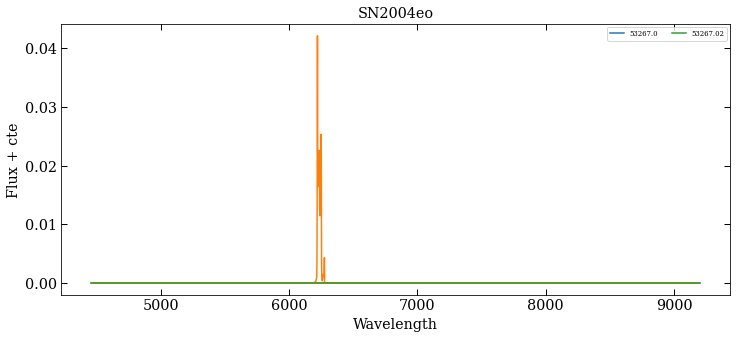

#########################################################################################################################
Interpolation between dates: 53267.0 53268.01
Producing grid with dates: [53267. 53268. 53269.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53268.01 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53268.01 53268.0 0.990099009898993
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53268.01 53269.0 1.980198019797986
regularization term: 5e-07
--------------------------------------


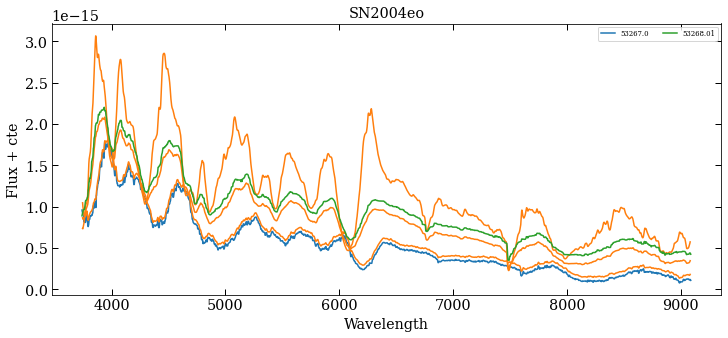

#########################################################################################################################
Interpolation between dates: 53267.0 53272.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.0 53268.0 0.2
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.0 53269.0 0.4
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.0 53270.0 0.6
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.0 53271.0 0.8
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.0 

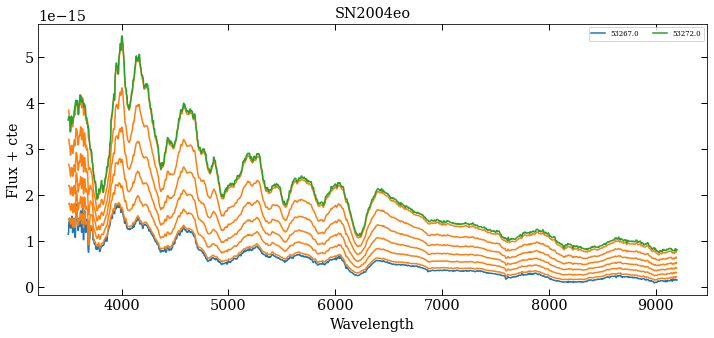

#########################################################################################################################
Interpolation between dates: 53267.0 53272.2
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.2 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.2 53268.0 0.19230769230779993
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.2 53269.0 0.38461538461559985
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.2 53270.0 0.5769230769233998
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53272.2 53271.0 0.7692307692311997
regularization term: 5e-07
--------------------------------

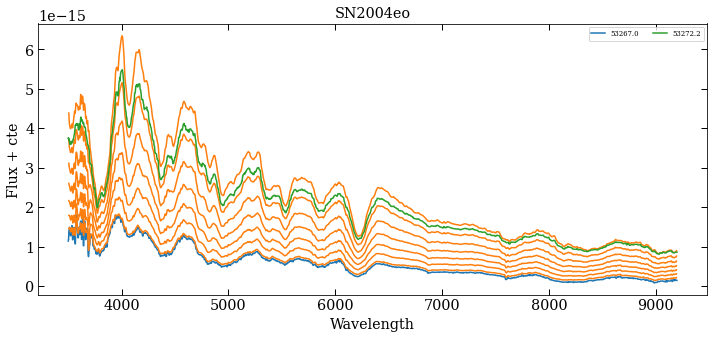

#########################################################################################################################
Interpolation between dates: 53267.0 53275.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53275.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53275.0 53268.0 0.125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53275.0 53269.0 0.25
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53275.0 53270.0 0.375
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53275.0 53271.0 0.5
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha

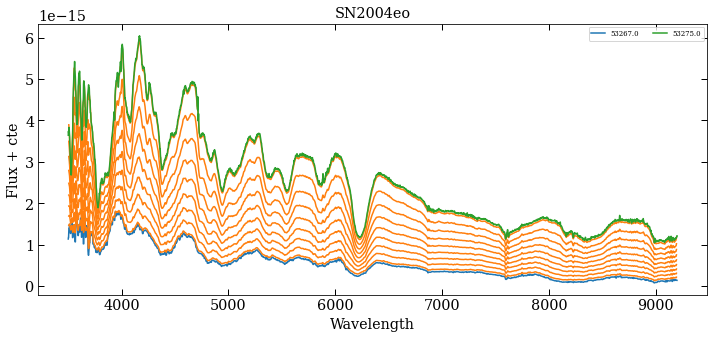

#########################################################################################################################
Interpolation between dates: 53267.0 53280.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53280.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53280.0 53268.0 0.07692307692307693
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53280.0 53269.0 0.15384615384615385
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53280.0 53270.0 0.23076923076923078
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53280.0 53271.0 0.3076923076923077
regulari

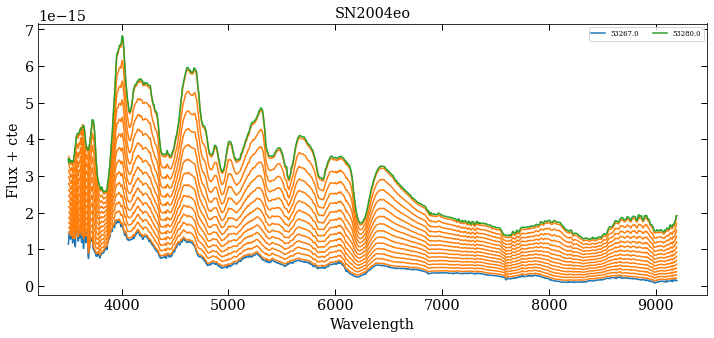

#########################################################################################################################
Interpolation between dates: 53267.0 53285.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53285.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53285.0 53268.0 0.05555555555555555
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53285.0 53269.0 0.1111111111111111
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53285.0 53270.0 0.16666666666666666
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53285.0 5

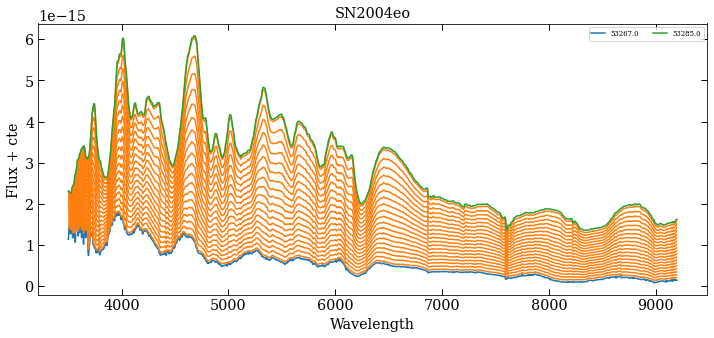

#########################################################################################################################
Interpolation between dates: 53267.0 53289.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53289.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53289.0 53268.0 0.045454545454545456
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53289.0 53269.0 0.09090909090909091
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53289.0 53270.0 0.13636363636363635
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | A

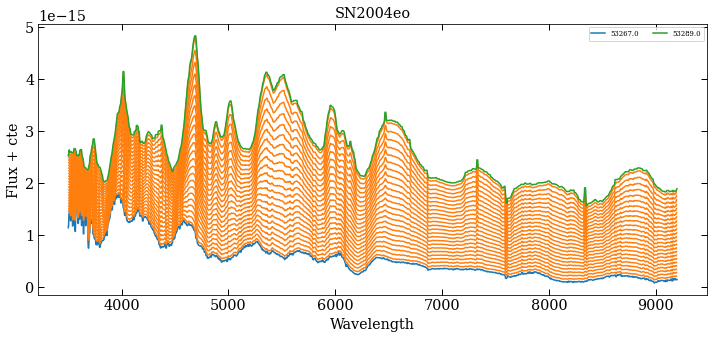

#########################################################################################################################
Interpolation between dates: 53267.0 53291.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.0 53268.0 0.041666666666666664
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.0 53269.0 0.08333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.0 53270.0 0.125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | A

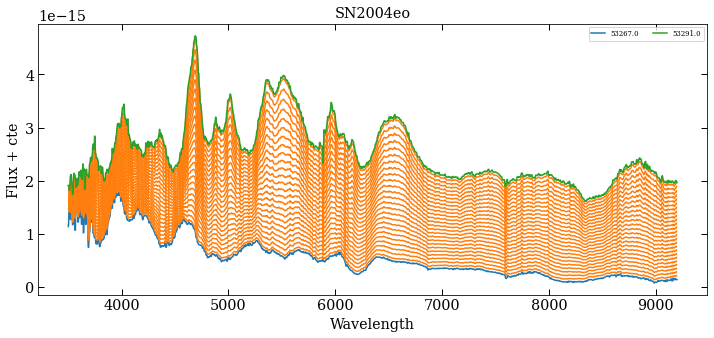

#########################################################################################################################
Interpolation between dates: 53267.0 53291.3
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.3 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.3 53268.0 0.04115226337448067
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.3 53269.0 0.08230452674896134
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53291.3 53270.0 0.123456790123442
regularization term: 5e-07
--------------------------------------
Name | Iinicio

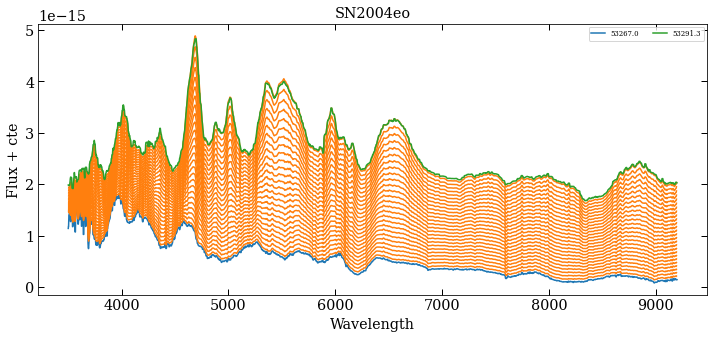

#########################################################################################################################
Interpolation between dates: 53267.0 53292.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53292.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53292.0 53268.0 0.04
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53292.0 53269.0 0.08
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53292.0 53270.0 0.12
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 532

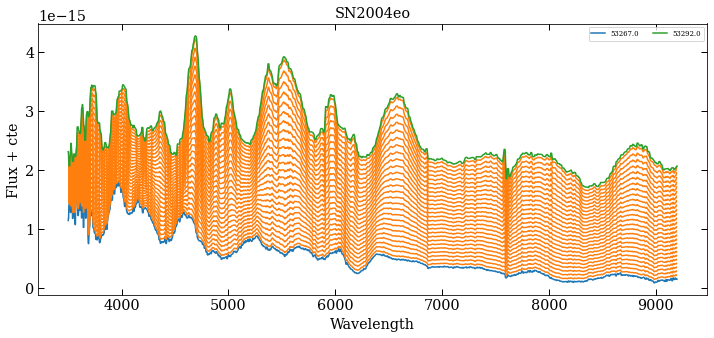

#########################################################################################################################
Interpolation between dates: 53267.0 53299.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53299.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53299.0 53268.0 0.03125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53299.0 53269.0 0.0625
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53299.0 53270.0 0.09375
regularization term: 5e-07
--------------------------------------

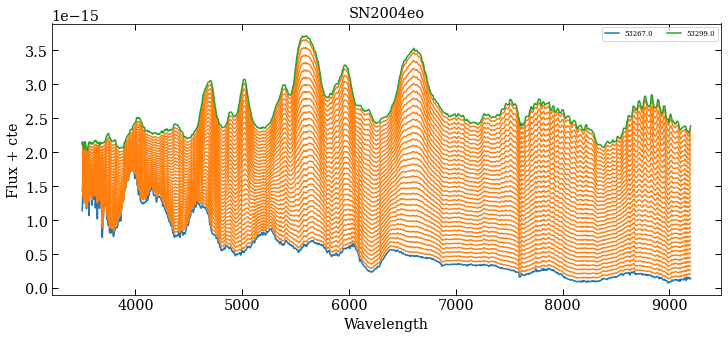

#########################################################################################################################
Interpolation between dates: 53267.0 53300.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53300.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53300.0 53268.0 0.030303030303030304
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53300.0 53269.0 0.06060606060606061
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53300.0 53270.0 0.09090909090909091
regularization term:

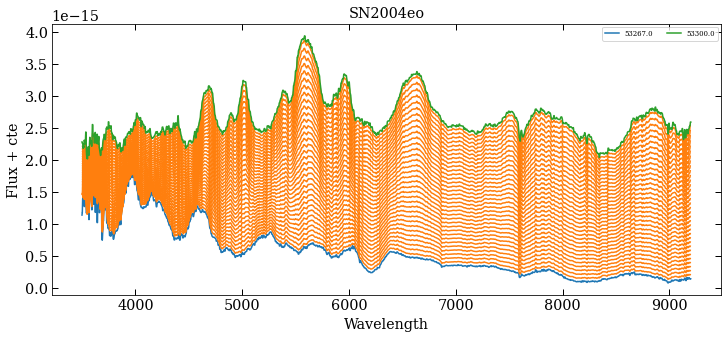

#########################################################################################################################
Interpolation between dates: 53267.0 53302.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300. 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53302.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53302.0 53268.0 0.02857142857142857
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53302.0 53269.0 0.05714285714285714
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53302.0 53270.0 0.08571428571428572
regular

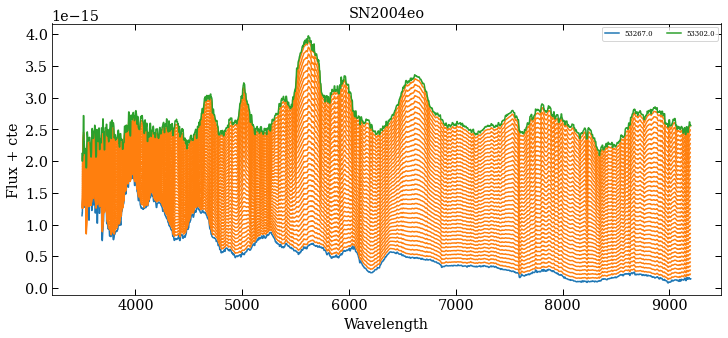

#########################################################################################################################
Interpolation between dates: 53267.0 53303.02
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53303.02 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53303.02 53268.0 0.027762354247642666
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53303.02 53269.0 0.05552470849528533
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53303.02 53270.0 0.08328

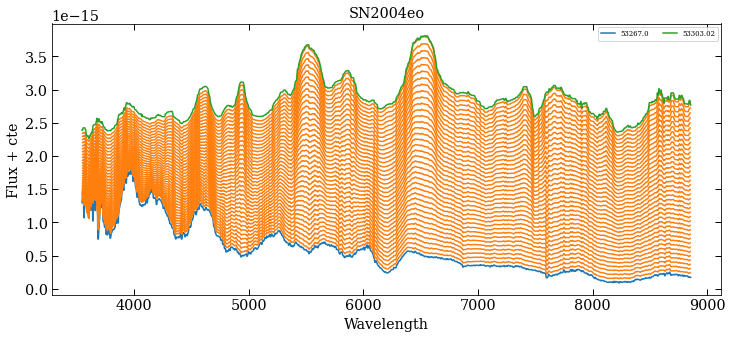

#########################################################################################################################
Interpolation between dates: 53267.0 53308.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306.
 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53308.0 53267.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53308.0 53268.0 0.024390243902439025
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0 53308.0 53269.0 0.04878048780487805
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.0

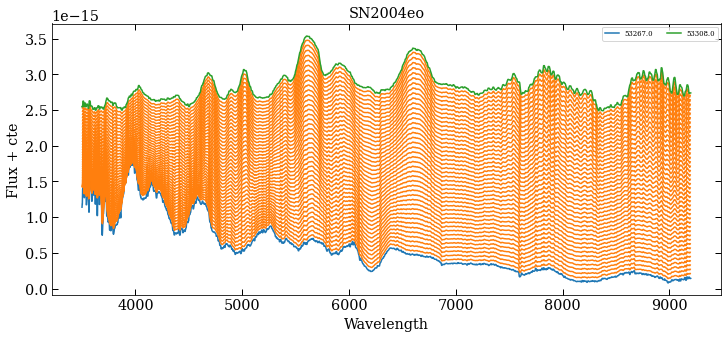

#########################################################################################################################
Interpolation between dates: 53267.0 53323.0
Interpolation between dates: 53267.0 53324.0
Interpolation between dates: 53267.0 53327.0
Interpolation between dates: 53267.0 53328.0
Interpolation between dates: 53267.0 53332.0
Interpolation between dates: 53267.0 53346.0
Interpolation between dates: 53267.0 53350.0
Interpolation between dates: 53267.02 53268.01
Producing grid with dates: [53267. 53268. 53269.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53268.01 53267.0 0.020202020198679543
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53268.01 53268.0 0.9898989898969855
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53268.01 53269.0 1.9999999999926505
regularization term: 5e-07
--------------------------------

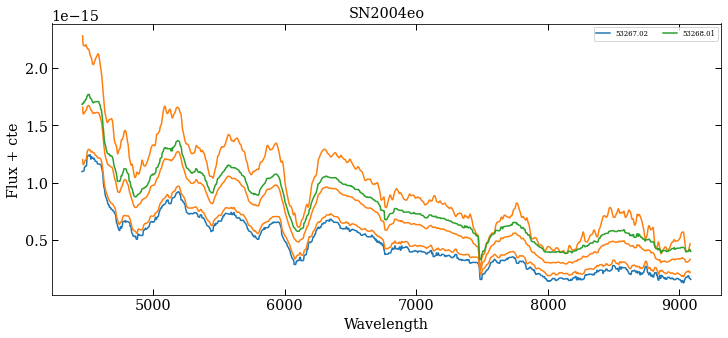

#########################################################################################################################
Interpolation between dates: 53267.02 53272.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.0 53267.0 0.004016064256382675
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.0 53268.0 0.19678714859489385
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.0 53269.0 0.3975903614461704
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.0 53270.0 0.5983935742974469
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.0 53271.0 0.7991967871487234
regularization term: 5e-07
-----------------

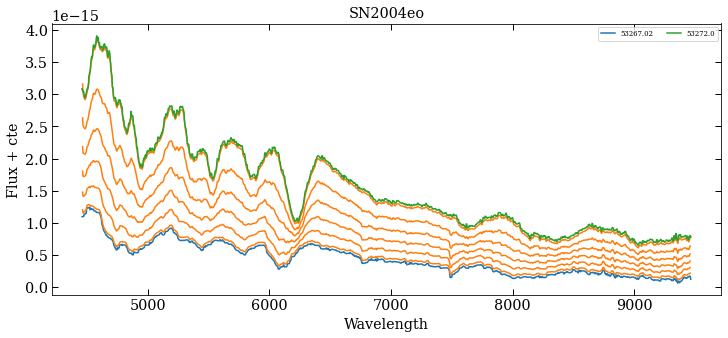

#########################################################################################################################
Interpolation between dates: 53267.02 53272.2
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.2 53267.0 0.003861003860385609
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.2 53268.0 0.1891891891897966
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.2 53269.0 0.3822393822399788
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.2 53270.0 0.575289575290161
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53272.2 53271.0 0.7683397683403432
regularization term: 5e-07
------------

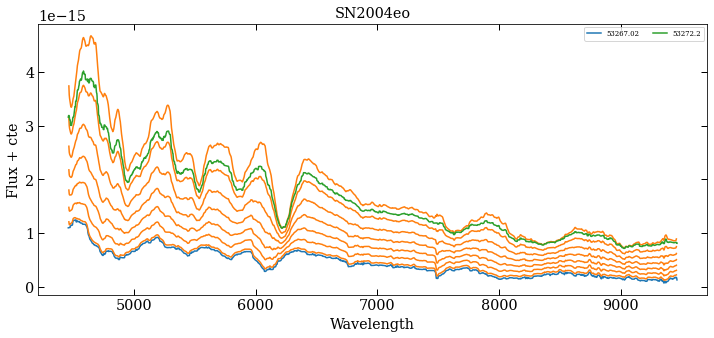

#########################################################################################################################
Interpolation between dates: 53267.02 53275.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53275.0 53267.0 0.0025062656637582148
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53275.0 53268.0 0.12280701754421156
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53275.0 53269.0 0.24812030075218133
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53275.0 53270.0 0.37343358396015114
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53275.0 53271.0 0.4987468671681209
regularization term:

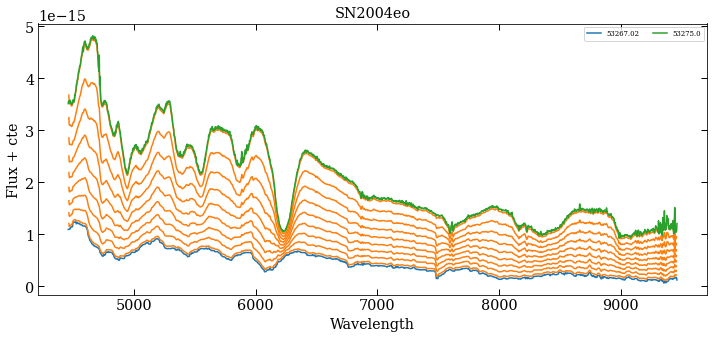

#########################################################################################################################
Interpolation between dates: 53267.02 53280.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53280.0 53267.0 0.001540832049059603
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53280.0 53268.0 0.07550077041625268
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53280.0 53269.0 0.15254237288156494
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53280.0 53270.0 0.22958397534687722
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53280.0 53271.0 0.30

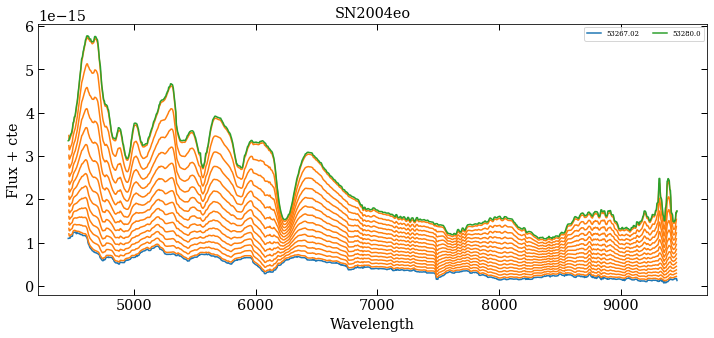

#########################################################################################################################
Interpolation between dates: 53267.02 53285.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53285.0 53267.0 0.0011123470521020589
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53285.0 53268.0 0.05450500556190361
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53285.0 53269.0 0.11012235817590928
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53285.0 53270.0 0.16573971078991495
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN

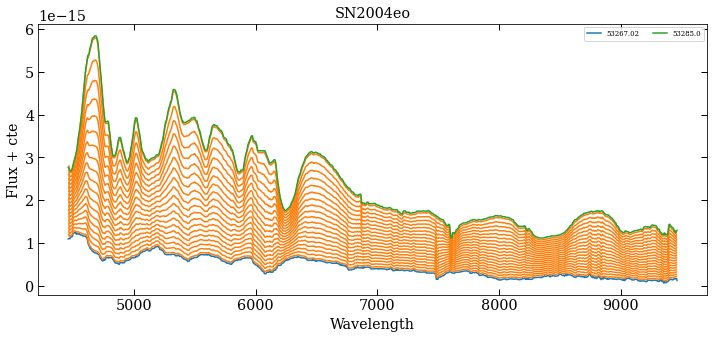

#########################################################################################################################
Interpolation between dates: 53267.02 53289.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53289.0 53267.0 0.0009099181072245526
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53289.0 53268.0 0.04458598726128565
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53289.0 53269.0 0.09008189262979586
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53289.0 53270.0 0.13557779799830608
regularization term: 5e-07
--------------------------------------
Name | Iin

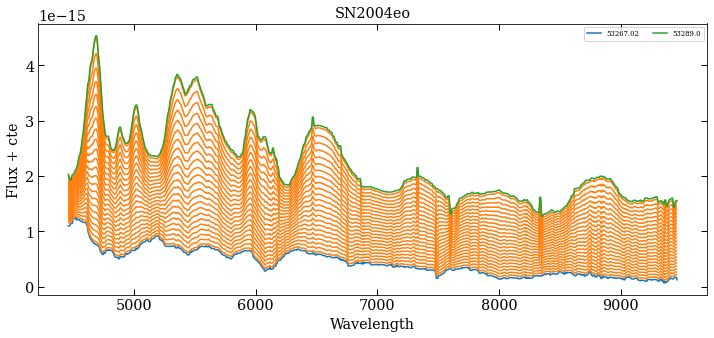

#########################################################################################################################
Interpolation between dates: 53267.02 53291.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.0 53267.0 0.0008340283568305216
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.0 53268.0 0.04086738949137075
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.0 53269.0 0.08256880733957202
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.0 53270.0 0.1242702251877733
regularization term: 5e-07
------------------------------------

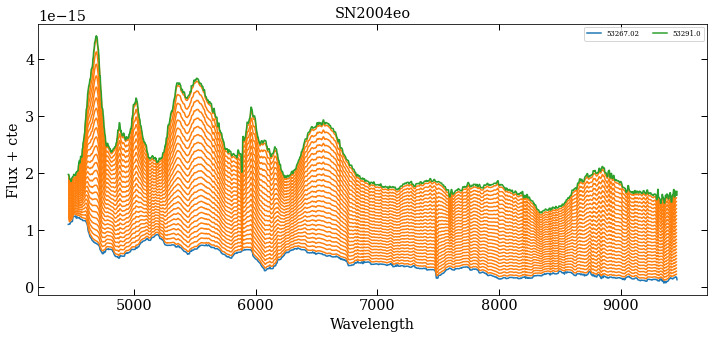

#########################################################################################################################
Interpolation between dates: 53267.02 53291.3
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.3 53267.0 0.0008237232288629961
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.3 53268.0 0.04036243822087952
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.3 53269.0 0.08154859967062203
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53291.3 53270.0 0.12273476112036455
regularization term: 5e-07
----------------------------

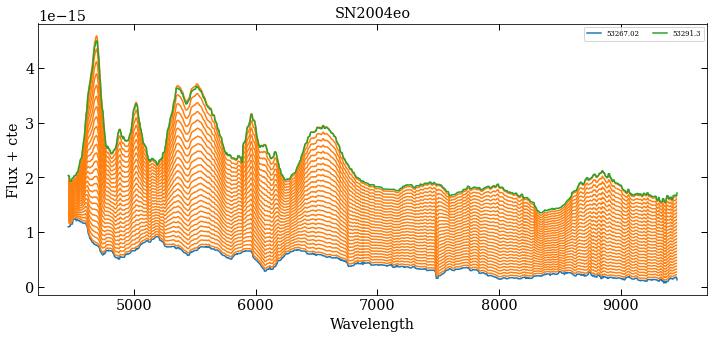

#########################################################################################################################
Interpolation between dates: 53267.02 53292.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53292.0 53267.0 0.0008006405122816659
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53292.0 53268.0 0.0392313851082096
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53292.0 53269.0 0.07926341072870087
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53292.0 53270.0 0.11929543634919214
regularization term: 5e-07
-----------------------------

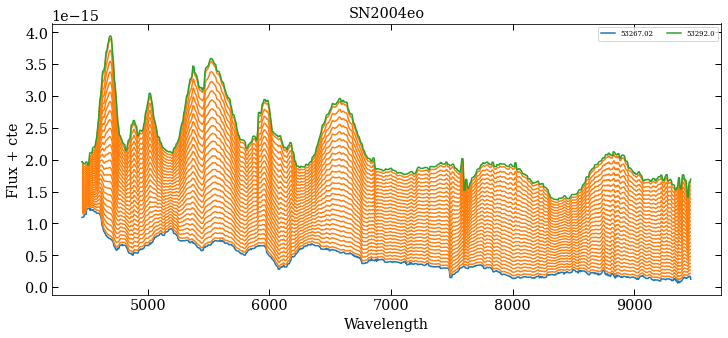

#########################################################################################################################
Interpolation between dates: 53267.02 53299.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53299.0 53267.0 0.0006253908691931388
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53299.0 53268.0 0.030644152595469147
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53299.0 53269.0 0.06191369606013143
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53299.0 53270.0 0.09318323952479372
regu

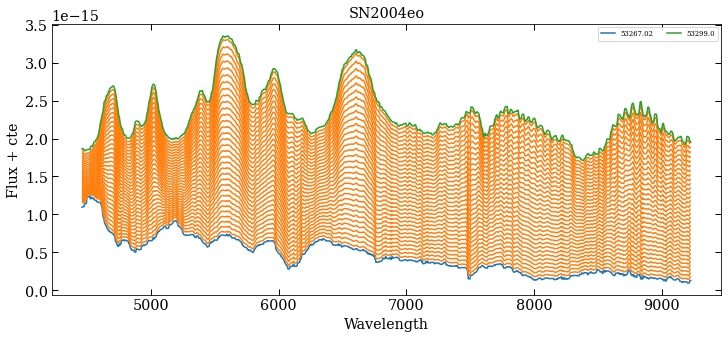

#########################################################################################################################
Interpolation between dates: 53267.02 53300.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53300.0 53267.0 0.000606428138168485
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53300.0 53268.0 0.029714978775109348
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53300.0 53269.0 0.06003638568838718
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53300.0 53270.0 0.0903577926016650

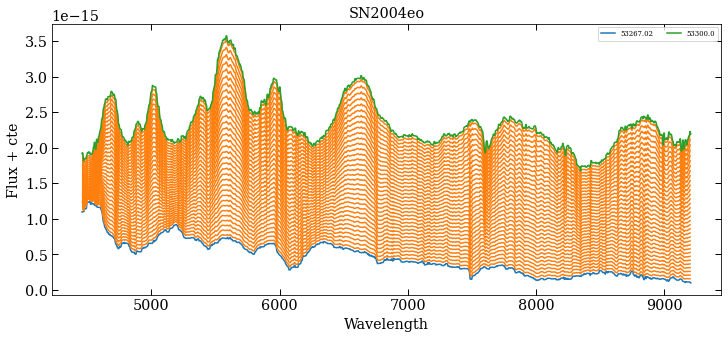

#########################################################################################################################
Interpolation between dates: 53267.02 53302.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300. 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53302.0 53267.0 0.000571755288644847
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53302.0 53268.0 0.028016009148173576
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53302.0 53269.0 0.056603773584992
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53302.0 53270.0 0.0851

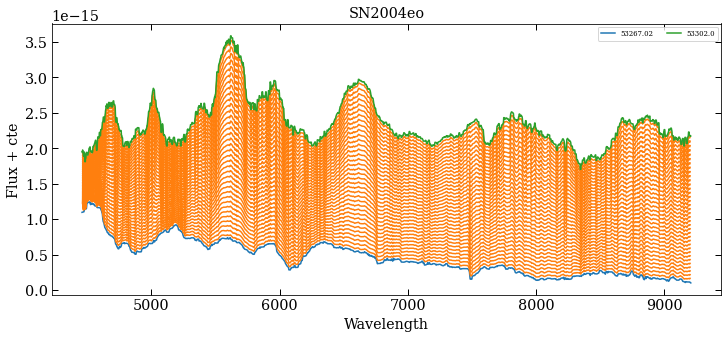

#########################################################################################################################
Interpolation between dates: 53267.02 53303.02
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53303.02 53267.0 0.0005555555554666272
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53303.02 53268.0 0.02722222222231115
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53303.02 53269.0 0.05500000000008893
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53

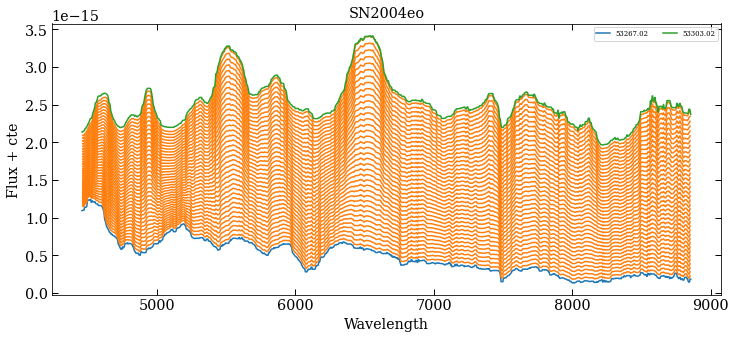

#########################################################################################################################
Interpolation between dates: 53267.02 53308.0
Producing grid with dates: [53267. 53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276.
 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286.
 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296.
 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306.
 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53308.0 53267.0 0.0004880429477012449
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53308.0 53268.0 0.023914104441267077
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53267.02 53308.0 53269.0 0.0483162518302354
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | A

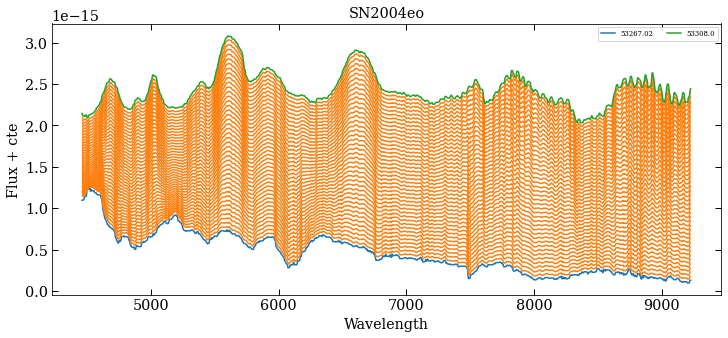

#########################################################################################################################
Interpolation between dates: 53267.02 53323.0
Interpolation between dates: 53267.02 53324.0
Interpolation between dates: 53267.02 53327.0
Interpolation between dates: 53267.02 53328.0
Interpolation between dates: 53267.02 53332.0
Interpolation between dates: 53267.02 53346.0
Interpolation between dates: 53267.02 53350.0
Interpolation between dates: 53268.01 53272.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.0 53268.0 0.0025062656646722744
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.0 53269.0 0.2481203007514958
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.0 53270.0 0.49874686716766387
regularization term: 5e-07
-------------

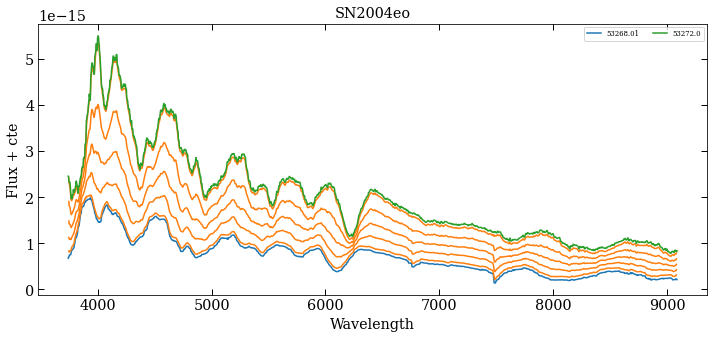

#########################################################################################################################
Interpolation between dates: 53268.01 53272.2
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.2 53268.0 0.002386634845357775
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.2 53269.0 0.23627684964179754
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.2 53270.0 0.47494033412895287
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.2 53271.0 0.7136038186161082
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53272.2 53272.0 0.9522673031032636
regularization term: 5e-07
----------------

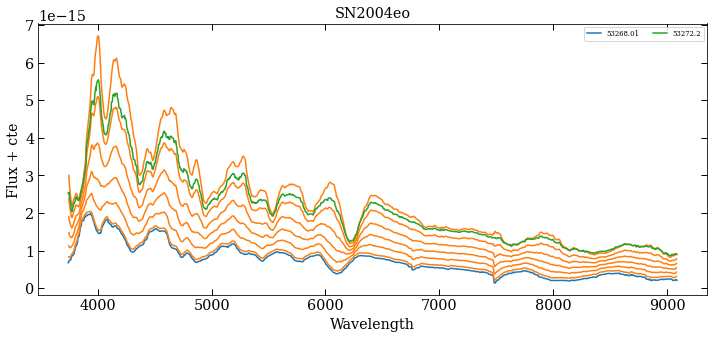

#########################################################################################################################
Interpolation between dates: 53268.01 53275.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53275.0 53268.0 0.0014306151648126155
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53275.0 53269.0 0.14163090128730346
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53275.0 53270.0 0.28469241773941956
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53275.0 53271.0 0.4277539341915356
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53275.0 53272.0 0.5708154506436517
regularization term: 5e-07
-

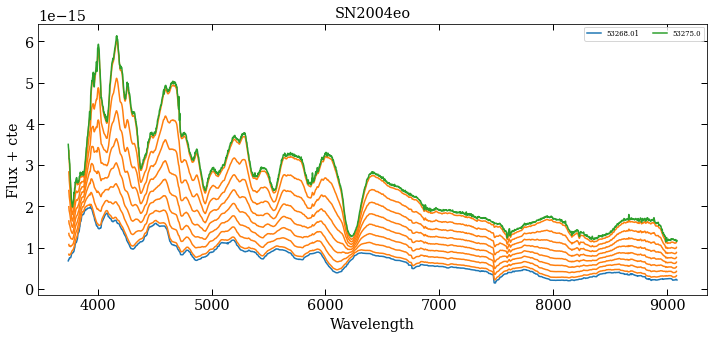

#########################################################################################################################
Interpolation between dates: 53268.01 53280.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53280.0 53268.0 0.0008340283571341924
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53280.0 53269.0 0.08256880733929366
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53280.0 53270.0 0.1659716430357215
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53280.0 53271.0 0.24937447873214935
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53280.0 53272.0 0.332777314

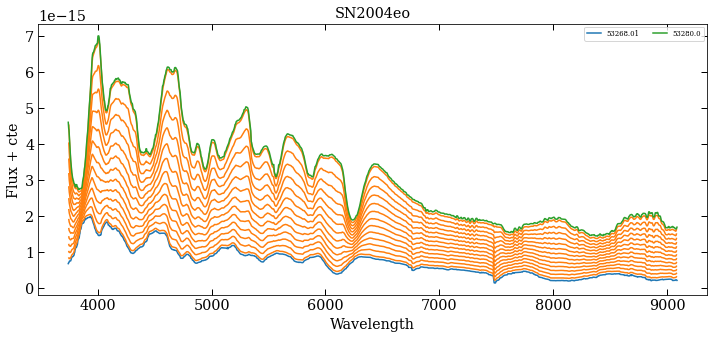

#########################################################################################################################
Interpolation between dates: 53268.01 53285.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53285.0 53268.0 0.0005885815186602982
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53285.0 53269.0 0.058269570335378544
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53285.0 53270.0 0.11712772218941739
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53285.0 53271.0 0.17598587404345623
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo

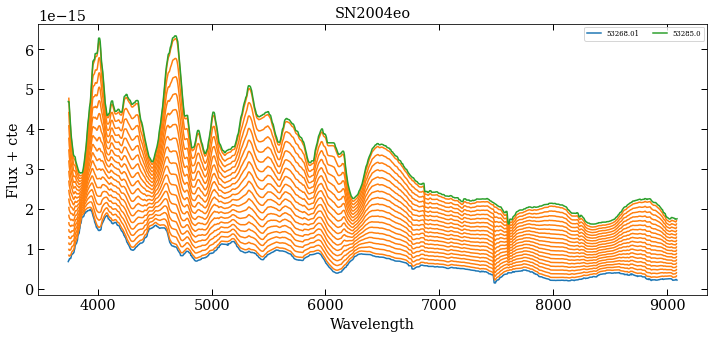

#########################################################################################################################
Interpolation between dates: 53268.01 53289.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53289.0 53268.0 0.00047641734168833917
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53289.0 53269.0 0.04716531681743968
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53289.0 53270.0 0.09480705097656769
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53289.0 53271.0 0.1424487851356957
regularization term: 5e-07
--------------------------------------
Name | Iinicio | 

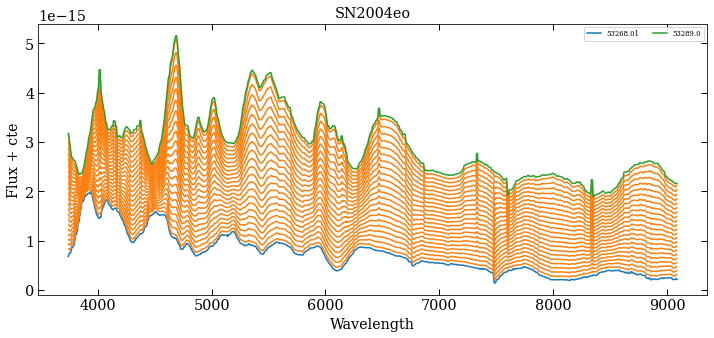

#########################################################################################################################
Interpolation between dates: 53268.01 53291.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.0 53268.0 0.0004349717269264095
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.0 53269.0 0.043062200956853
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.0 53270.0 0.0865593736406324
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.0 53271.0 0.13005654632441183
regularization term: 5e-07
--------------------------------------
Name |

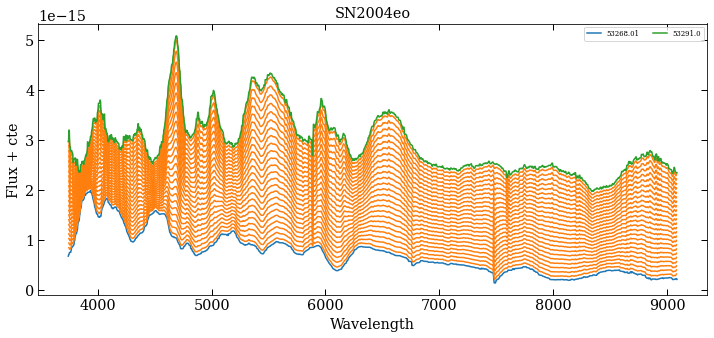

#########################################################################################################################
Interpolation between dates: 53268.01 53291.3
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.3 53268.0 0.0004293688279105579
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.3 53269.0 0.042507513954397835
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.3 53270.0 0.08544439673670623
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53291.3 53271.0 0.12838127951901462
regularization term: 5e-07
----------------------------------

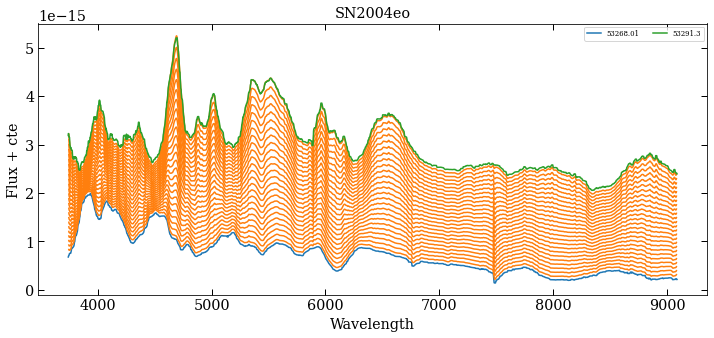

#########################################################################################################################
Interpolation between dates: 53268.01 53292.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53292.0 53268.0 0.0004168403502308511
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53292.0 53269.0 0.0412671946643621
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53292.0 53270.0 0.08295122967895505
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53292.0 53271.0 0.124635264693548
regularization term: 5e-07
--------------------------------------

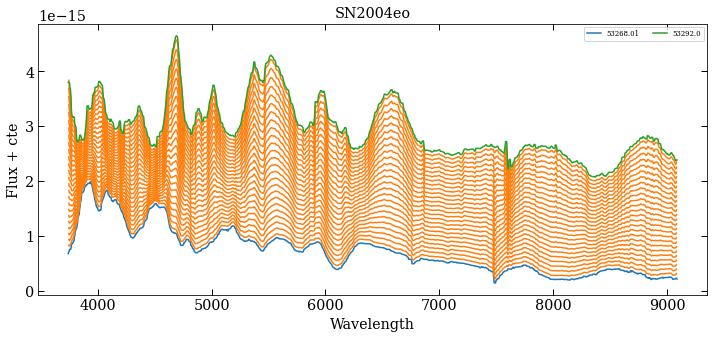

#########################################################################################################################
Interpolation between dates: 53268.01 53299.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297.
 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53299.0 53268.0 0.0003226847370777001
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53299.0 53269.0 0.03194578896411836
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53299.0 53270.0 0.06421426266531441
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53299.0 53271.0 0.09648273636651046
regularizati

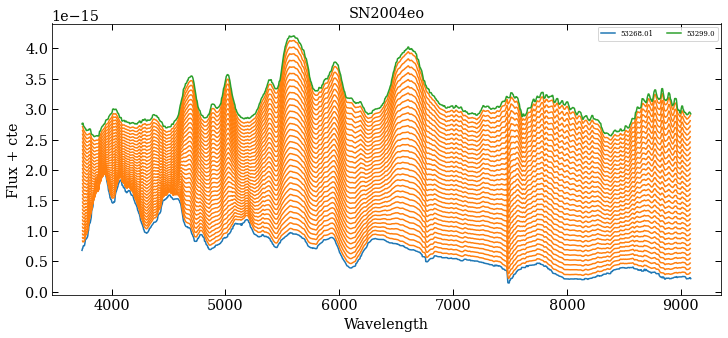

#########################################################################################################################
Interpolation between dates: 53268.01 53300.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297.
 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53300.0 53268.0 0.0003125976868408223
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53300.0 53269.0 0.030947170990872953
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53300.0 53270.0 0.06220693966858673
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53300.0 53271.0 0.09346670834630051
regu

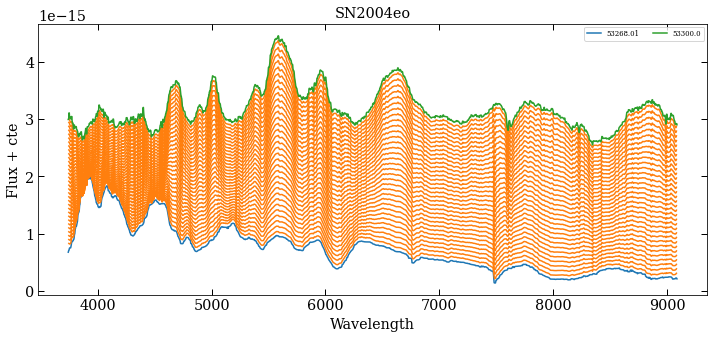

#########################################################################################################################
Interpolation between dates: 53268.01 53302.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297.
 53298. 53299. 53300. 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53302.0 53268.0 0.0002942041777592782
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53302.0 53269.0 0.029126213592174818
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53302.0 53270.0 0.058546631362108914
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53302.0 53271.0 0.0879670

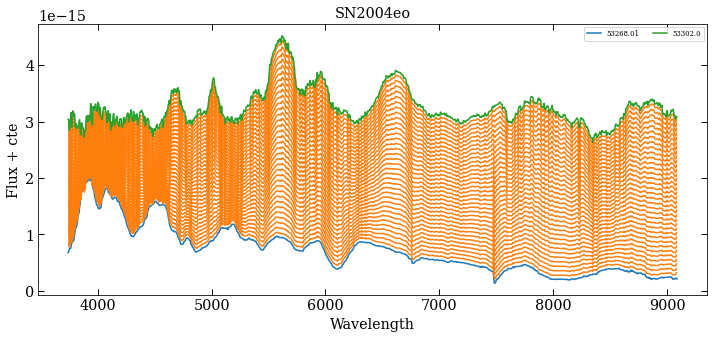

#########################################################################################################################
Interpolation between dates: 53268.01 53303.02
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297.
 53298. 53299. 53300. 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53303.02 53268.0 0.00028563267643641146
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53303.02 53269.0 0.02827763496138563
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53303.02 53270.0 0.05684090259920767
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53303.02

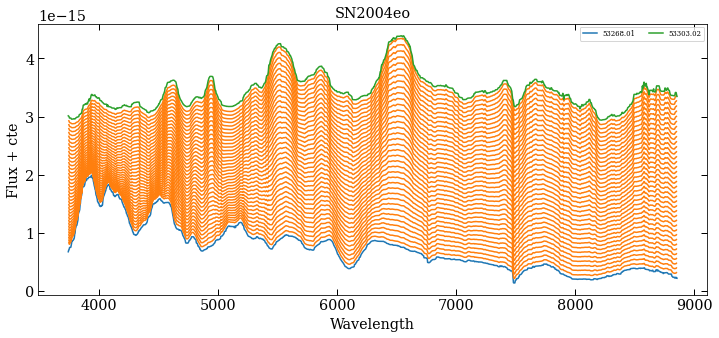

#########################################################################################################################
Interpolation between dates: 53268.01 53308.0
Producing grid with dates: [53268. 53269. 53270. 53271. 53272. 53273. 53274. 53275. 53276. 53277.
 53278. 53279. 53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287.
 53288. 53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297.
 53298. 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307.
 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53308.0 53268.0 0.00025006251567986443
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53308.0 53269.0 0.02475618904721213
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53268.01 53308.0 53270.0 0.04976244061010413
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
S

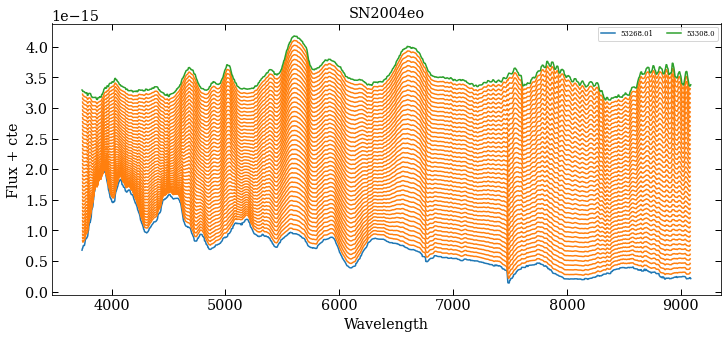

#########################################################################################################################
Interpolation between dates: 53268.01 53323.0
Interpolation between dates: 53268.01 53324.0
Interpolation between dates: 53268.01 53327.0
Interpolation between dates: 53268.01 53328.0
Interpolation between dates: 53268.01 53332.0
Interpolation between dates: 53268.01 53346.0
Interpolation between dates: 53268.01 53350.0
Interpolation between dates: 53272.0 53272.2
Producing grid with dates: [53272. 53273.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53272.2 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53272.2 53273.0 5.00000000007276
regularization term: 5e-07
--------------------------------------


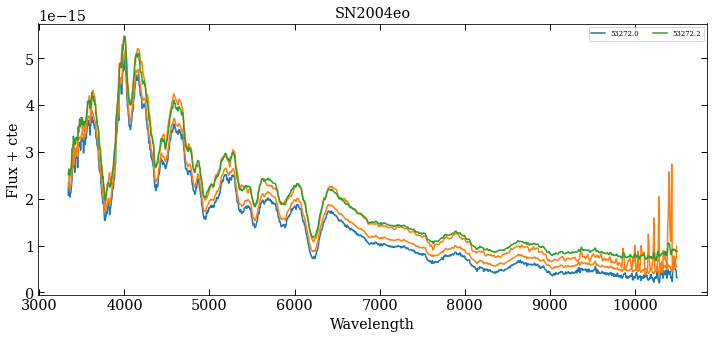

#########################################################################################################################
Interpolation between dates: 53272.0 53275.0
Producing grid with dates: [53272. 53273. 53274. 53275.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53275.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53275.0 53273.0 0.3333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53275.0 53274.0 0.6666666666666666
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53275.0 53275.0 1.0
regularization term: 5e-07
--------------------------------------


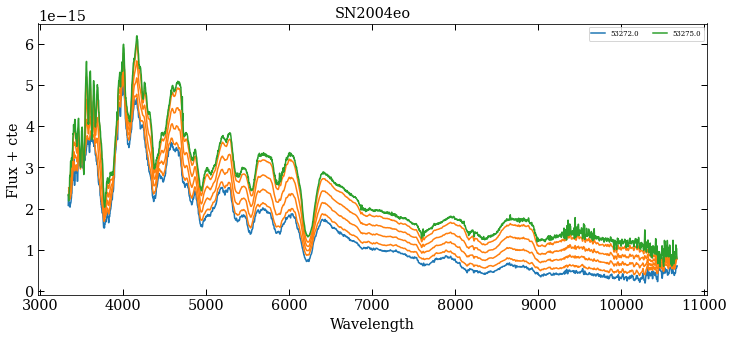

#########################################################################################################################
Interpolation between dates: 53272.0 53280.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53280.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53280.0 53273.0 0.125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53280.0 53274.0 0.25
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53280.0 53275.0 0.375
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53280.0 53276.0 0.5
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha

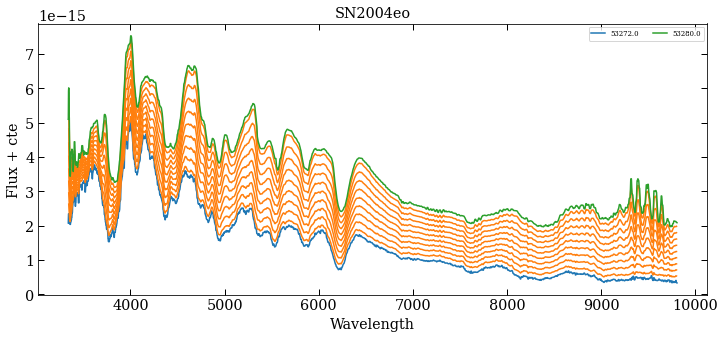

#########################################################################################################################
Interpolation between dates: 53272.0 53285.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53285.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53285.0 53273.0 0.07692307692307693
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53285.0 53274.0 0.15384615384615385
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53285.0 53275.0 0.23076923076923078
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53285.0 53276.0 0.3076923076923077
regulari

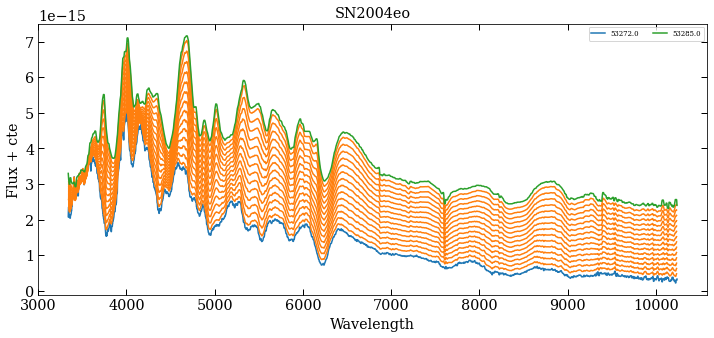

#########################################################################################################################
Interpolation between dates: 53272.0 53289.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53289.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53289.0 53273.0 0.058823529411764705
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53289.0 53274.0 0.11764705882352941
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53289.0 53275.0 0.17647058823529413
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53289.0 53276.

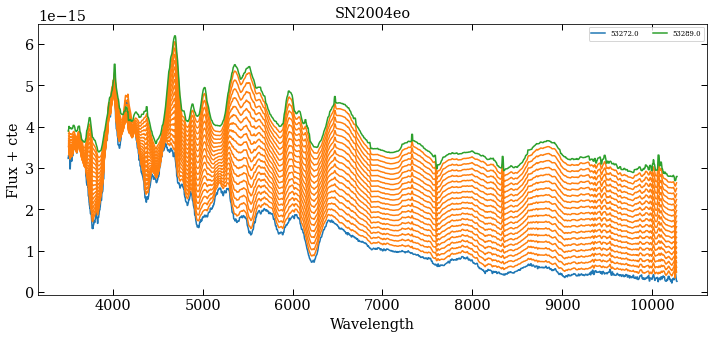

#########################################################################################################################
Interpolation between dates: 53272.0 53291.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.0 53273.0 0.05263157894736842
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.0 53274.0 0.10526315789473684
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.0 53275.0 0.15789473684210525
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 5

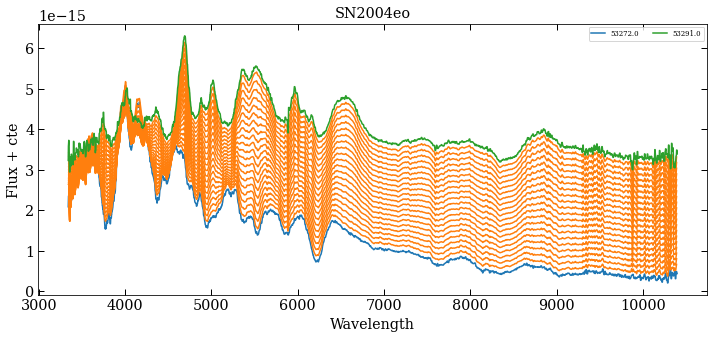

#########################################################################################################################
Interpolation between dates: 53272.0 53291.3
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.3 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.3 53273.0 0.05181347150258286
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.3 53274.0 0.10362694300516571
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53291.3 53275.0 0.1554404145077486
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53

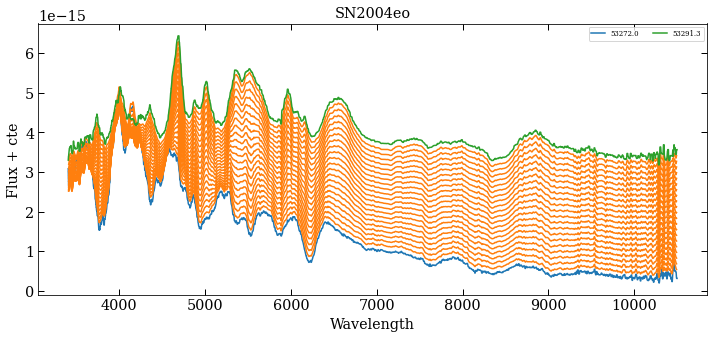

#########################################################################################################################
Interpolation between dates: 53272.0 53292.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53292.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53292.0 53273.0 0.05
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53292.0 53274.0 0.1
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53292.0 53275.0 0.15
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53292.0 53276.0 0.2
regularization term

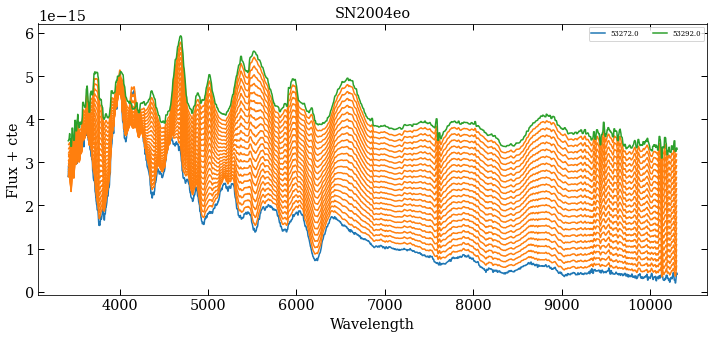

#########################################################################################################################
Interpolation between dates: 53272.0 53299.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53299.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53299.0 53273.0 0.037037037037037035
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53299.0 53274.0 0.07407407407407407
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53299.0 53275.0 0.1111111111111111
regularization term: 5e-07
-------------------------------------

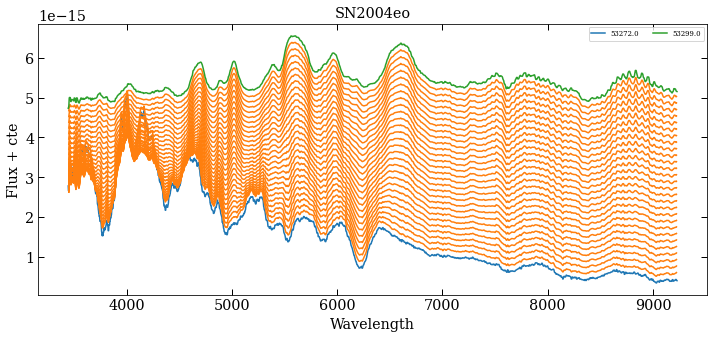

#########################################################################################################################
Interpolation between dates: 53272.0 53300.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53300.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53300.0 53273.0 0.03571428571428571
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53300.0 53274.0 0.07142857142857142
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53300.0 53275.0 0.10714285714285714
regularization term: 5e-07
------------------------------

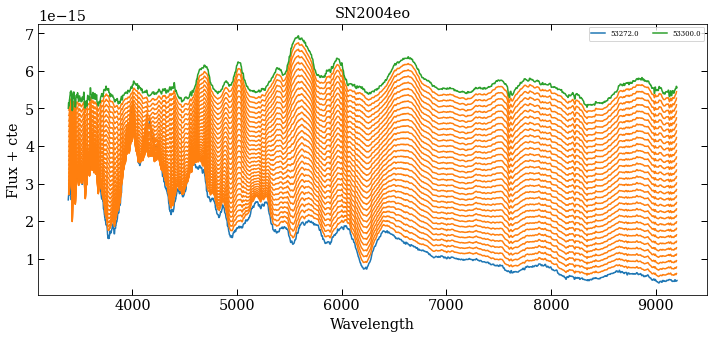

#########################################################################################################################
Interpolation between dates: 53272.0 53302.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300. 53301.
 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53302.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53302.0 53273.0 0.03333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53302.0 53274.0 0.06666666666666667
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53302.0 53275.0 0.1
regularization term: 5e-07
-------------------------------

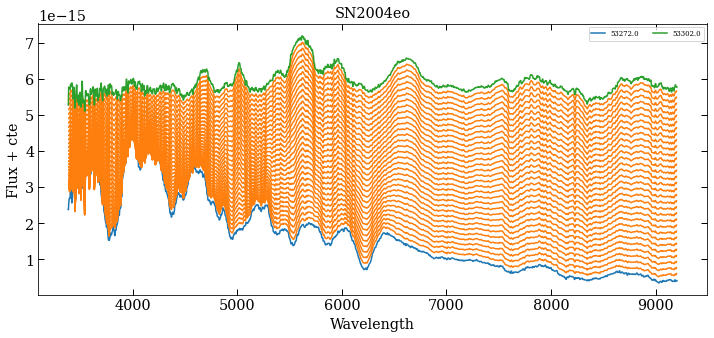

#########################################################################################################################
Interpolation between dates: 53272.0 53303.02
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300. 53301.
 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53303.02 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53303.02 53273.0 0.0322372662798228
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53303.02 53274.0 0.0644745325596456
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53303.02 53275.0 0.0967117988394684
regularization term: 5e-07

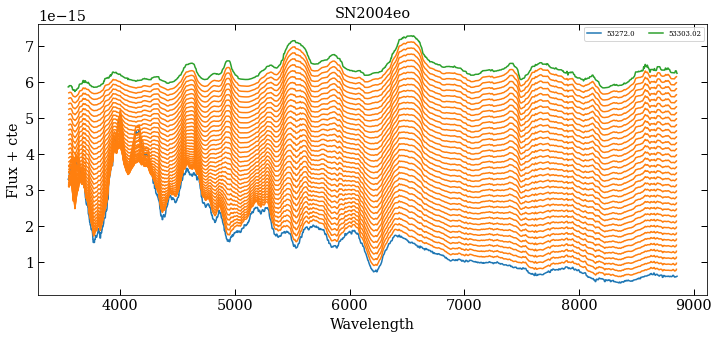

#########################################################################################################################
Interpolation between dates: 53272.0 53308.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300. 53301.
 53302. 53303. 53304. 53305. 53306. 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53308.0 53272.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53308.0 53273.0 0.027777777777777776
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53308.0 53274.0 0.05555555555555555
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.0 53308.0 53275.0 0.08333333333333333

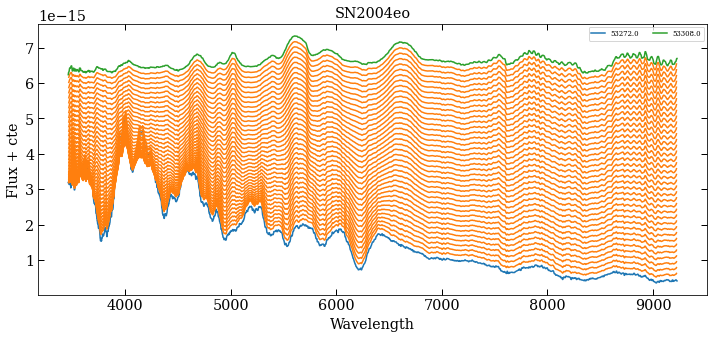

#########################################################################################################################
Interpolation between dates: 53272.0 53323.0
Interpolation between dates: 53272.0 53324.0
Interpolation between dates: 53272.0 53327.0
Interpolation between dates: 53272.0 53328.0
Interpolation between dates: 53272.0 53332.0
Interpolation between dates: 53272.0 53346.0
Interpolation between dates: 53272.0 53350.0
Interpolation between dates: 53272.2 53275.0
Producing grid with dates: [53272. 53273. 53274. 53275.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53275.0 53272.0 0.07142857142745776
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53275.0 53273.0 0.28571428571502816
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53275.0 53274.0 0.642857142857514
regularization term: 5e-07
----------------------------------

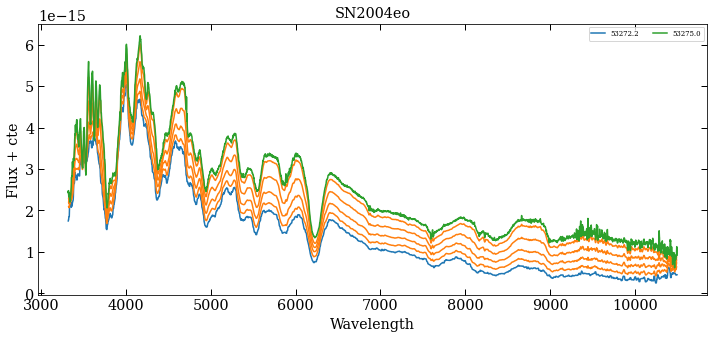

#########################################################################################################################
Interpolation between dates: 53272.2 53280.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53280.0 53272.0 0.025641025640642946
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53280.0 53273.0 0.10256410256443742
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53280.0 53274.0 0.2307692307695178
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53280.0 53275.0 0.3589743589745982
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53280.0 53276.0 0.4871794871796785
regularization term: 5e-07
--

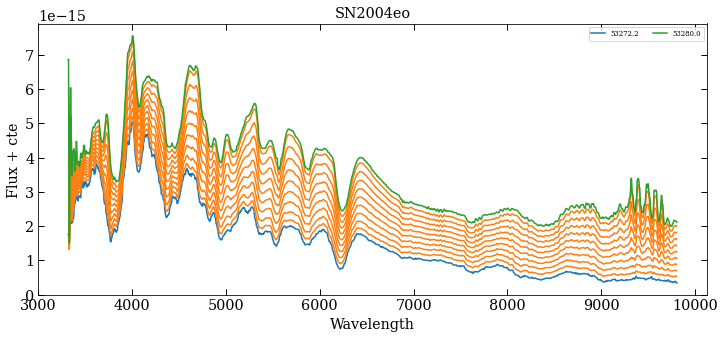

#########################################################################################################################
Interpolation between dates: 53272.2 53285.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53285.0 53272.0 0.015624999999769074
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53285.0 53273.0 0.06250000000021316
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53285.0 53274.0 0.1406250000001954
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53285.0 53275.0 0.21875000000017764
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53285.0 53276.0 0.296875000

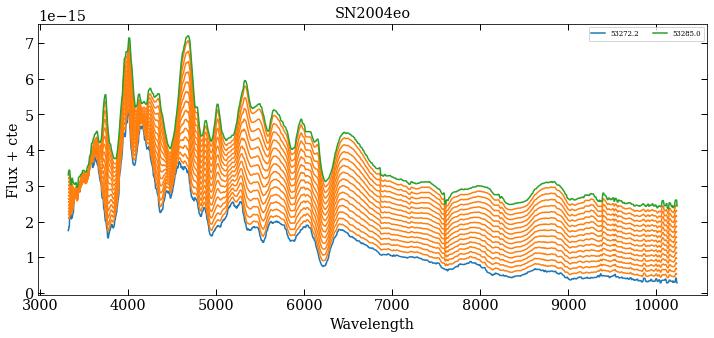

#########################################################################################################################
Interpolation between dates: 53272.2 53289.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53289.0 53272.0 0.011904761904586605
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53289.0 53273.0 0.04761904761921261
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53289.0 53274.0 0.10714285714301182
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53289.0 53275.0 0.16666666666681104
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.

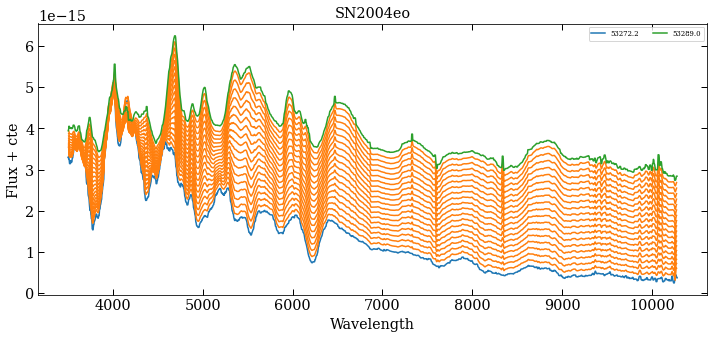

#########################################################################################################################
Interpolation between dates: 53272.2 53291.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.0 53272.0 0.01063829787218397
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.0 53273.0 0.04255319148950992
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.0 53274.0 0.09574468085120381
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.0 53275.0 0.1489361702128977
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2

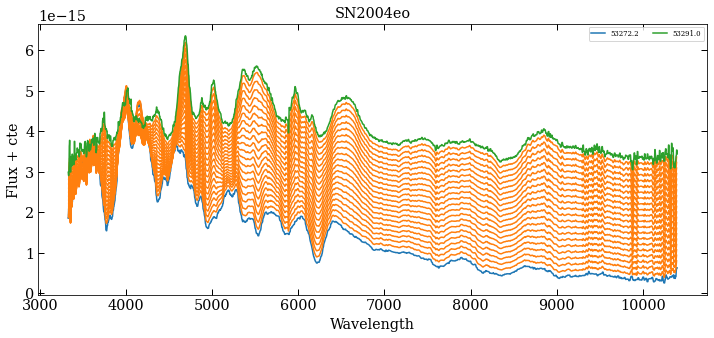

#########################################################################################################################
Interpolation between dates: 53272.2 53291.3
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.3 53272.0 0.010471204188326108
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.3 53273.0 0.041884816754066315
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.3 53274.0 0.09424083769645873
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53291.3 53275.0 0.14659685863885116
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter 

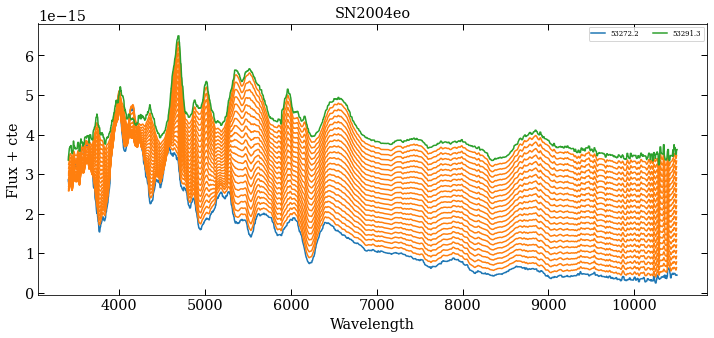

#########################################################################################################################
Interpolation between dates: 53272.2 53292.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53292.0 53272.0 0.010101010100861627
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53292.0 53273.0 0.040404040404181454
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53292.0 53274.0 0.09090909090922454
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53292.0 53275.0 0.1414141414142676
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter |

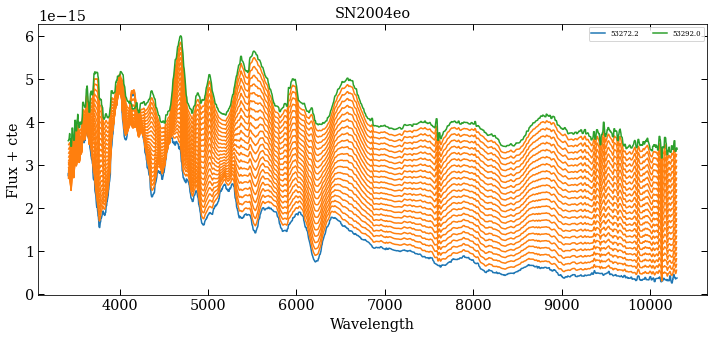

#########################################################################################################################
Interpolation between dates: 53272.2 53299.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53299.0 53272.0 0.0074626865670547726
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53299.0 53273.0 0.029850746268762073
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53299.0 53274.0 0.06716417910457892
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53299.0 53275.0 0.10447761194039576
regularization term: 5e-07
------------------

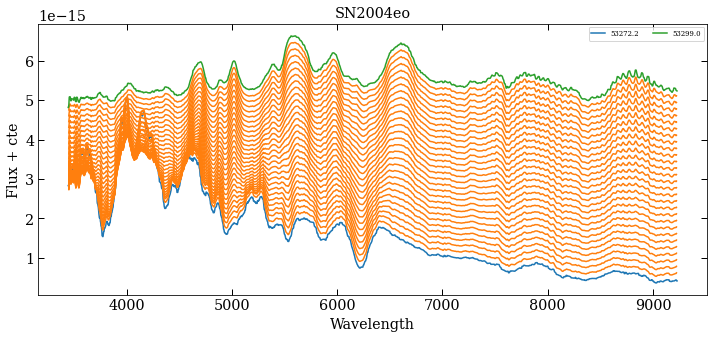

#########################################################################################################################
Interpolation between dates: 53272.2 53300.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53300.0 53272.0 0.007194244604211104
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53300.0 53273.0 0.028776978417367864
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53300.0 53274.0 0.06474820143894683
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53300.0 53275.0 0.1007194244605258
regularization term: 5e-07
-------------

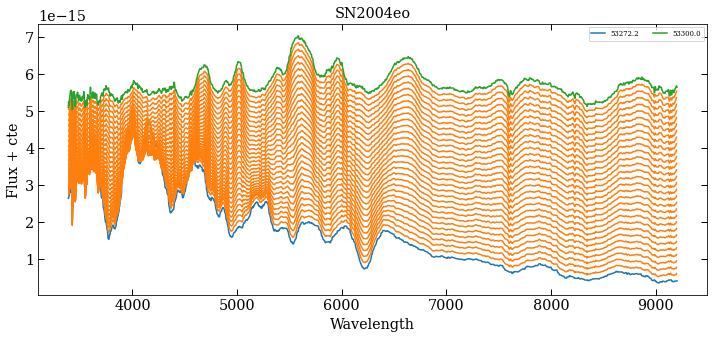

#########################################################################################################################
Interpolation between dates: 53272.2 53302.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300. 53301.
 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53302.0 53272.0 0.006711409395874835
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53302.0 53273.0 0.02684563758398766
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53302.0 53274.0 0.06040268456385015
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53302.0 53275.0 0.09395973154371265
regularization term: 5e-0

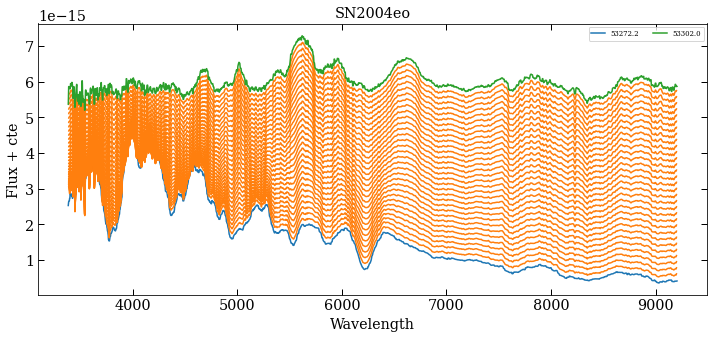

#########################################################################################################################
Interpolation between dates: 53272.2 53303.02
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300. 53301.
 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53303.02 53272.0 0.0064892926670049155
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53303.02 53273.0 0.025957170668491823
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53303.02 53274.0 0.058403634003988555
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53303.02 53275.0 0.09085009733948529
reg

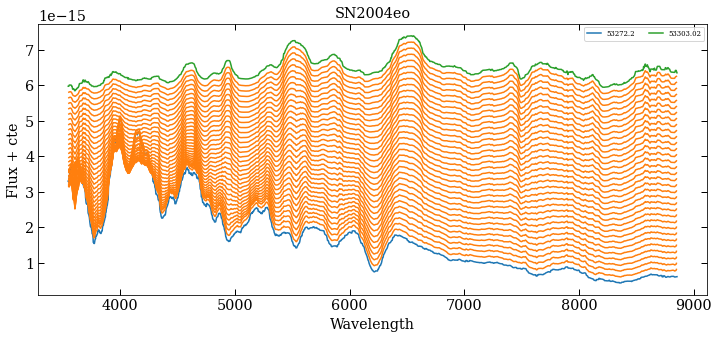

#########################################################################################################################
Interpolation between dates: 53272.2 53308.0
Producing grid with dates: [53272. 53273. 53274. 53275. 53276. 53277. 53278. 53279. 53280. 53281.
 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289. 53290. 53291.
 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300. 53301.
 53302. 53303. 53304. 53305. 53306. 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53308.0 53272.0 0.0055865921786892
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53308.0 53273.0 0.022346368715163278
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53308.0 53274.0 0.05027932960901576
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53272.2 53308.0 53275.0 0.07

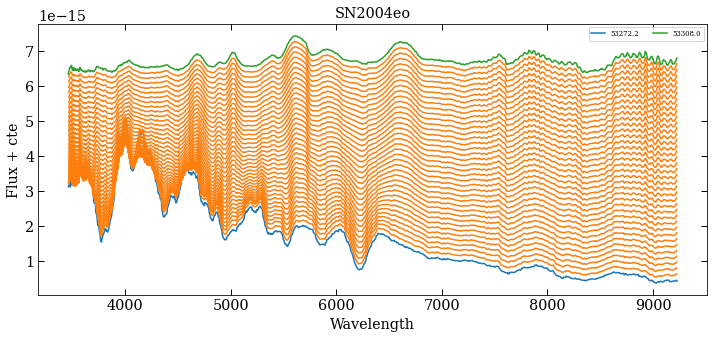

#########################################################################################################################
Interpolation between dates: 53272.2 53323.0
Interpolation between dates: 53272.2 53324.0
Interpolation between dates: 53272.2 53327.0
Interpolation between dates: 53272.2 53328.0
Interpolation between dates: 53272.2 53332.0
Interpolation between dates: 53272.2 53346.0
Interpolation between dates: 53272.2 53350.0
Interpolation between dates: 53275.0 53280.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53280.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53280.0 53276.0 0.2
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53280.0 53277.0 0.4
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inte

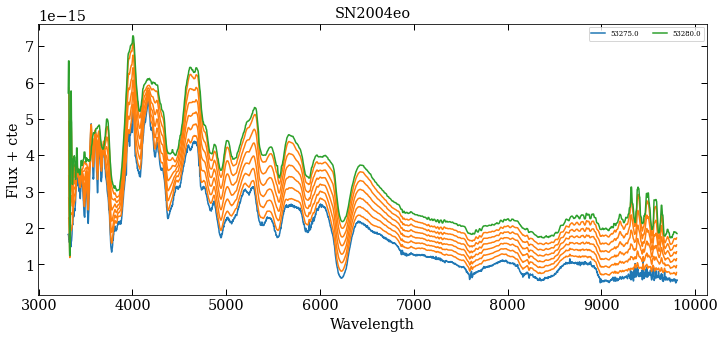

#########################################################################################################################
Interpolation between dates: 53275.0 53285.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53285.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53285.0 53276.0 0.1
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53285.0 53277.0 0.2
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53285.0 53278.0 0.3
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53285.0 53279.0 0.4
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Int

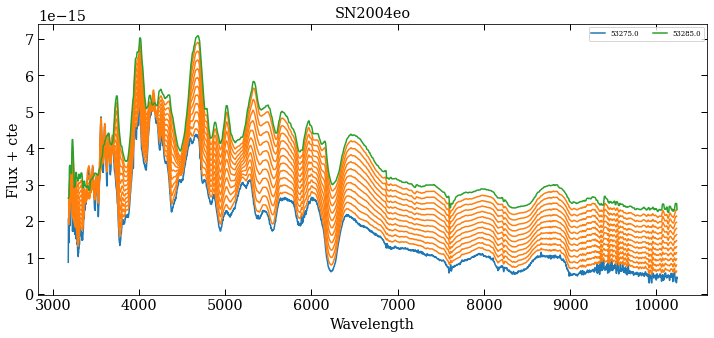

#########################################################################################################################
Interpolation between dates: 53275.0 53289.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53289.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53289.0 53276.0 0.07142857142857142
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53289.0 53277.0 0.14285714285714285
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53289.0 53278.0 0.21428571428571427
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53289.0 53279.0 0.2857142857142857
r

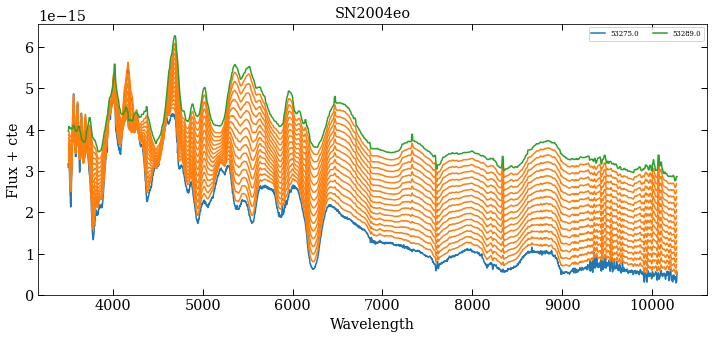

#########################################################################################################################
Interpolation between dates: 53275.0 53291.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.0 53276.0 0.0625
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.0 53277.0 0.125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.0 53278.0 0.1875
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.0 53279.0 0.25
regularization term: 5e-07
--------------

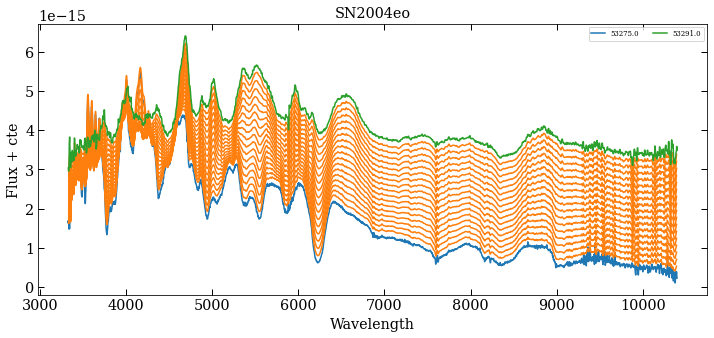

#########################################################################################################################
Interpolation between dates: 53275.0 53291.3
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.3 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.3 53276.0 0.061349693251522786
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.3 53277.0 0.12269938650304557
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.3 53278.0 0.18404907975456836
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53291.3 53279.

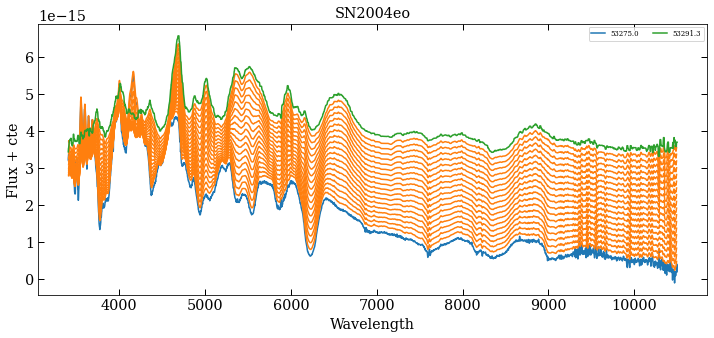

#########################################################################################################################
Interpolation between dates: 53275.0 53292.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53292.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53292.0 53276.0 0.058823529411764705
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53292.0 53277.0 0.11764705882352941
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53292.0 53278.0 0.17647058823529413
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53292.0 53279.

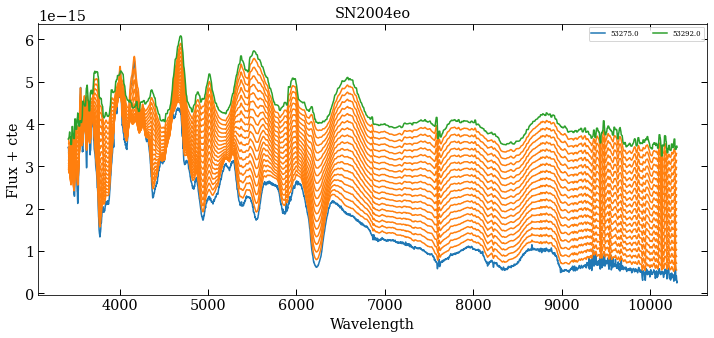

#########################################################################################################################
Interpolation between dates: 53275.0 53299.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53299.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53299.0 53276.0 0.041666666666666664
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53299.0 53277.0 0.08333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53299.0 53278.0 0.125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | A

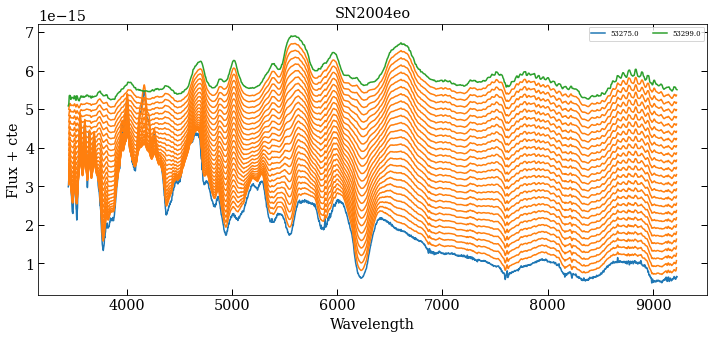

#########################################################################################################################
Interpolation between dates: 53275.0 53300.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53300.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53300.0 53276.0 0.04
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53300.0 53277.0 0.08
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53300.0 53278.0 0.12
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 533

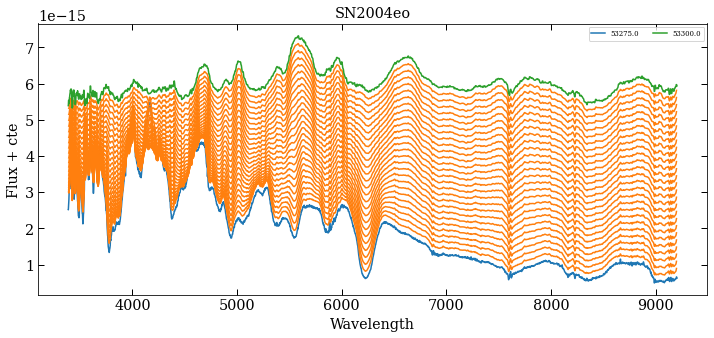

#########################################################################################################################
Interpolation between dates: 53275.0 53302.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53302.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53302.0 53276.0 0.037037037037037035
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53302.0 53277.0 0.07407407407407407
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53302.0 53278.0 0.1111111111111111
regularization term: 5e-07
-------------------------------------

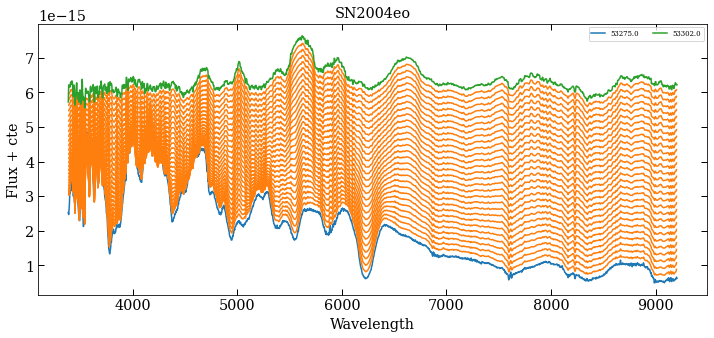

#########################################################################################################################
Interpolation between dates: 53275.0 53303.02
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53303.02 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53303.02 53276.0 0.03568879371877638
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53303.02 53277.0 0.07137758743755276
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53303.02 53278.0 0.10706638115632915
regularization term: 5e-07
------------------

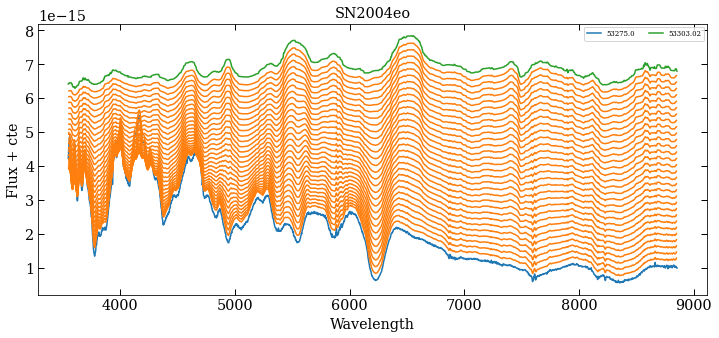

#########################################################################################################################
Interpolation between dates: 53275.0 53308.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53308.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53308.0 53276.0 0.030303030303030304
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53308.0 53277.0 0.06060606060606061
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53308.0 53278.0 0.09090909090909091
regularization term:

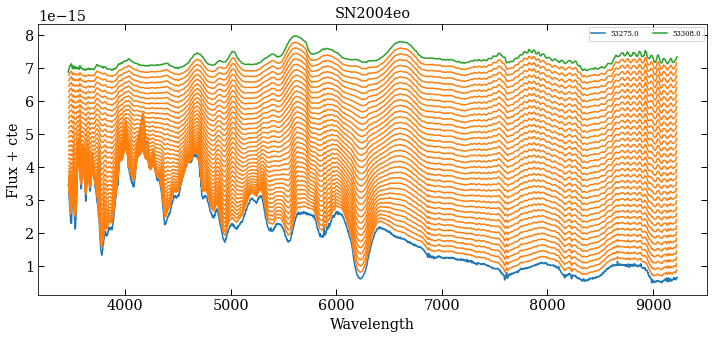

#########################################################################################################################
Interpolation between dates: 53275.0 53323.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308. 53309. 53310. 53311. 53312. 53313. 53314.
 53315. 53316. 53317. 53318. 53319. 53320. 53321. 53322. 53323.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53323.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53323.0 53276.0 0.020833333333333332
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53323.0 53277.0 0.041666666666666664
regularization term: 5e-07
--------------------------------------
Nam

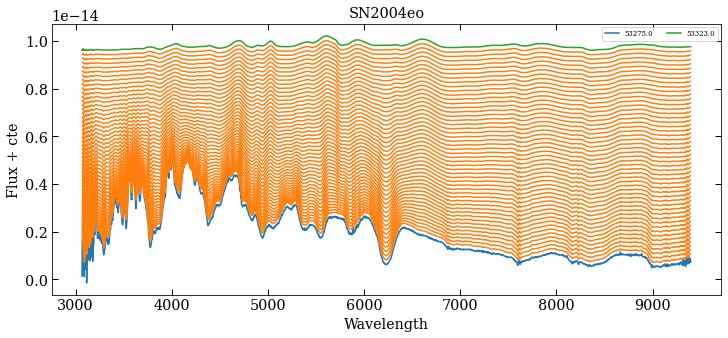

#########################################################################################################################
Interpolation between dates: 53275.0 53324.0
Producing grid with dates: [53275. 53276. 53277. 53278. 53279. 53280. 53281. 53282. 53283. 53284.
 53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308. 53309. 53310. 53311. 53312. 53313. 53314.
 53315. 53316. 53317. 53318. 53319. 53320. 53321. 53322. 53323. 53324.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53324.0 53275.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53324.0 53276.0 0.02040816326530612
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53275.0 53324.0 53277.0 0.04081632653061224
regularization term: 5e-07
-------------------------------------

regularization term: 5e-07
--------------------------------------


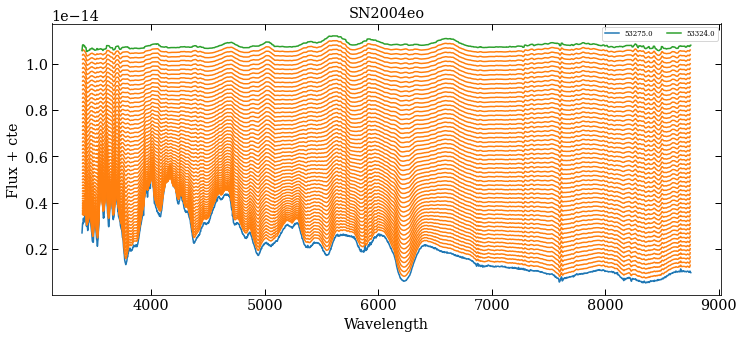

#########################################################################################################################
Interpolation between dates: 53275.0 53327.0
Interpolation between dates: 53275.0 53328.0
Interpolation between dates: 53275.0 53332.0
Interpolation between dates: 53275.0 53346.0
Interpolation between dates: 53275.0 53350.0
Interpolation between dates: 53280.0 53285.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53285.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53285.0 53281.0 0.2
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53285.0 53282.0 0.4
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53285.0 53283.0 0.6
regularization term: 5e-07
----------------

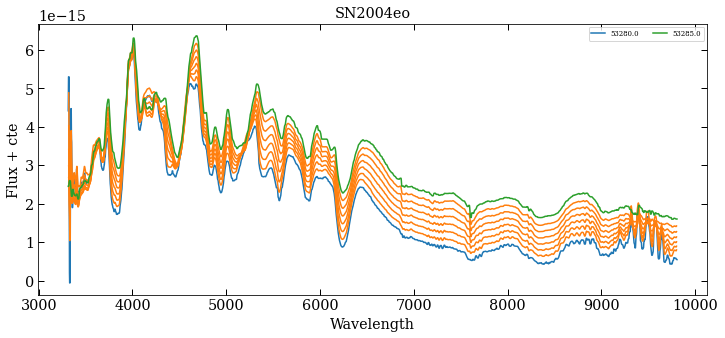

#########################################################################################################################
Interpolation between dates: 53280.0 53289.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53289.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53289.0 53281.0 0.1111111111111111
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53289.0 53282.0 0.2222222222222222
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53289.0 53283.0 0.3333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53289.0 53284.0 0.4444444444444444
regularization term: 5e-07
-------------

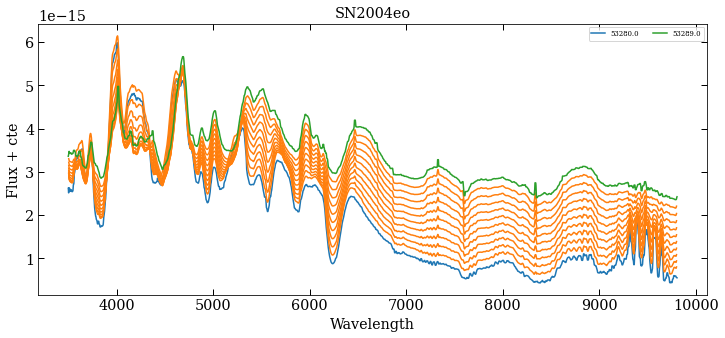

#########################################################################################################################
Interpolation between dates: 53280.0 53291.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.0 53281.0 0.09090909090909091
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.0 53282.0 0.18181818181818182
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.0 53283.0 0.2727272727272727
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.0 53284.0 0.36363636363636365
regularization term: 5

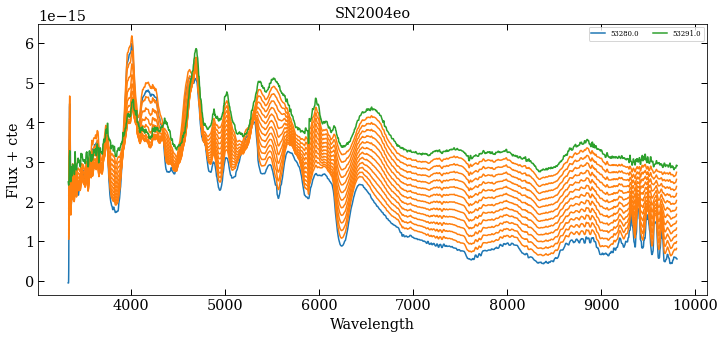

#########################################################################################################################
Interpolation between dates: 53280.0 53291.3
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.3 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.3 53281.0 0.08849557522121615
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.3 53282.0 0.1769911504424323
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.3 53283.0 0.26548672566364845
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53291.3 53284.0 0.3539823008848646
regularization t

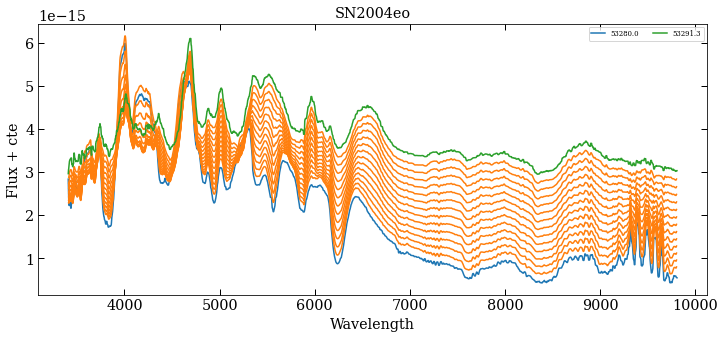

#########################################################################################################################
Interpolation between dates: 53280.0 53292.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53292.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53292.0 53281.0 0.08333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53292.0 53282.0 0.16666666666666666
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53292.0 53283.0 0.25
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53292.0 53284.0 0.3333333333333333
regularization term: 5e-07
---

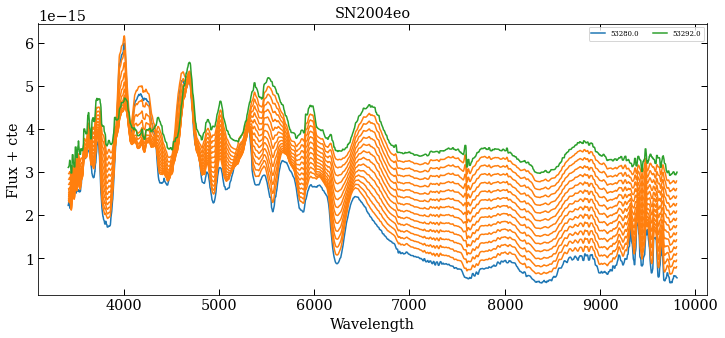

#########################################################################################################################
Interpolation between dates: 53280.0 53299.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53299.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53299.0 53281.0 0.05263157894736842
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53299.0 53282.0 0.10526315789473684
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53299.0 53283.0 0.15789473684210525
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 5

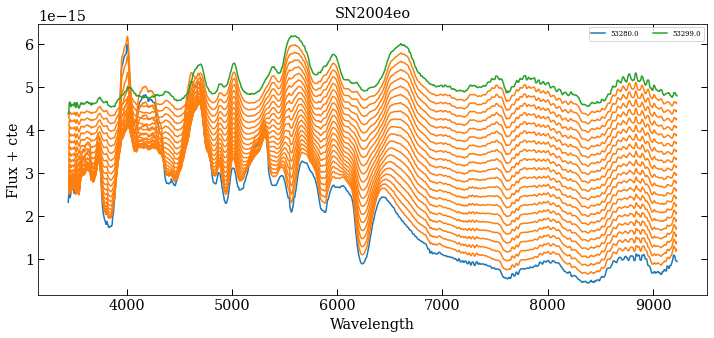

#########################################################################################################################
Interpolation between dates: 53280.0 53300.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53300.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53300.0 53281.0 0.05
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53300.0 53282.0 0.1
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53300.0 53283.0 0.15
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53300.0 53284.0 0.2
regularization term

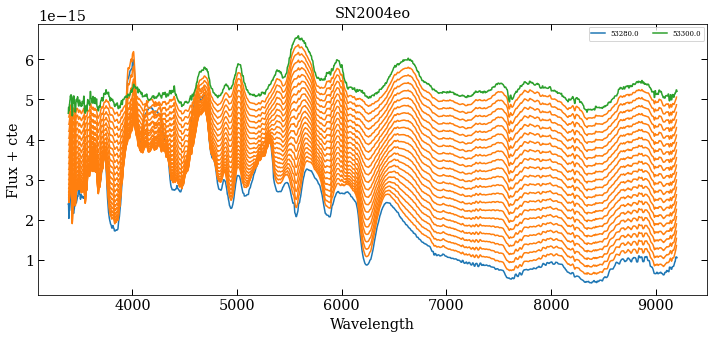

#########################################################################################################################
Interpolation between dates: 53280.0 53302.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300. 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53302.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53302.0 53281.0 0.045454545454545456
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53302.0 53282.0 0.09090909090909091
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53302.0 53283.0 0.13636363636363635
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | A

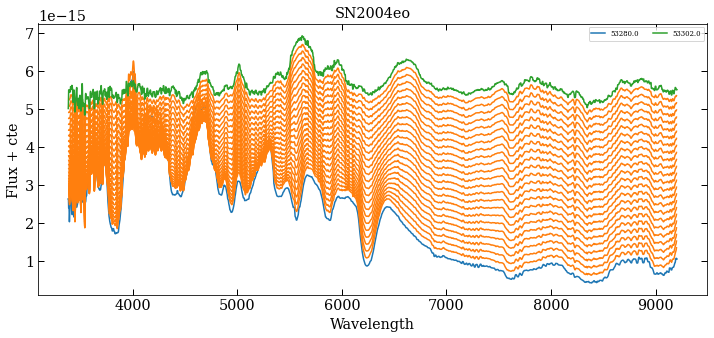

#########################################################################################################################
Interpolation between dates: 53280.0 53303.02
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300. 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53303.02 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53303.02 53281.0 0.04344048653345522
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53303.02 53282.0 0.08688097306691044
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53303.02 53283.0 0.13032145960036565
regularization term: 5e-07
--------------------------------------
Name | Iinicio

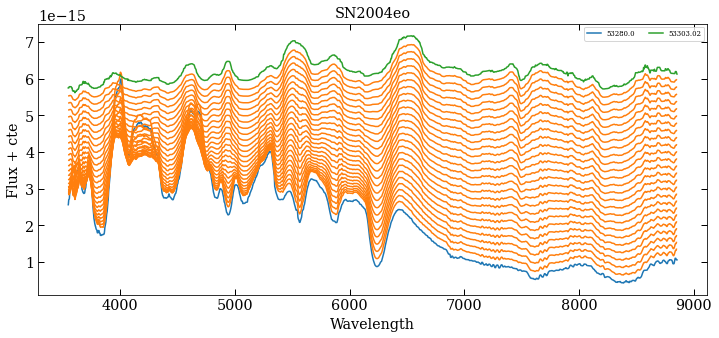

#########################################################################################################################
Interpolation between dates: 53280.0 53308.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53308.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53308.0 53281.0 0.03571428571428571
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53308.0 53282.0 0.07142857142857142
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53308.0 53283.0 0.10714285714285714
regularization term: 5e-07
------------------------------

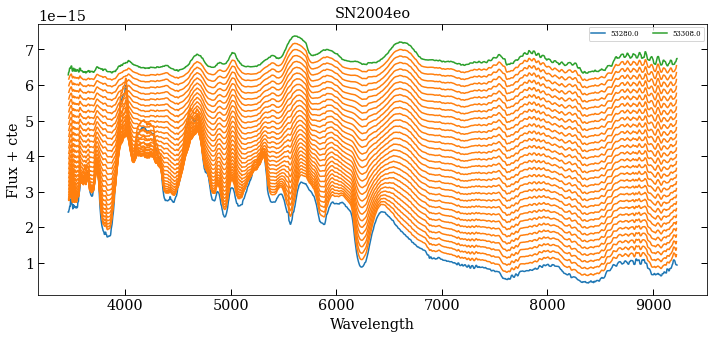

#########################################################################################################################
Interpolation between dates: 53280.0 53323.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308. 53309.
 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318. 53319.
 53320. 53321. 53322. 53323.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53323.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53323.0 53281.0 0.023255813953488372
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53323.0 53282.0 0.046511627906976744
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
S

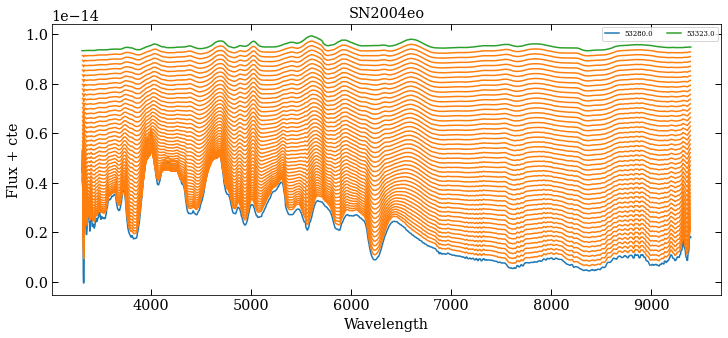

#########################################################################################################################
Interpolation between dates: 53280.0 53324.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308. 53309.
 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318. 53319.
 53320. 53321. 53322. 53323. 53324.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53324.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53324.0 53281.0 0.022727272727272728
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53324.0 53282.0 0.045454545454545456
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | 

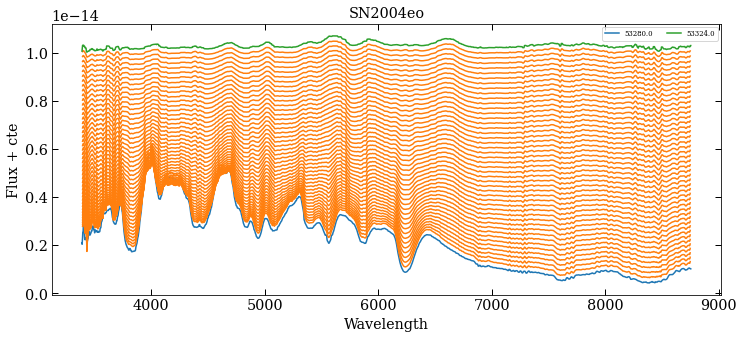

#########################################################################################################################
Interpolation between dates: 53280.0 53327.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308. 53309.
 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318. 53319.
 53320. 53321. 53322. 53323. 53324. 53325. 53326. 53327.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53327.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53327.0 53281.0 0.02127659574468085
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53327.0 53282.0 0.0425531914893617
regularization term: 5e-07
--------------------------------------
Name | Iinici

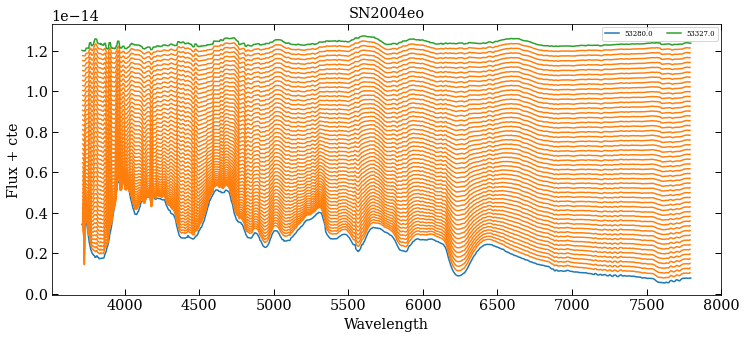

#########################################################################################################################
Interpolation between dates: 53280.0 53328.0
Producing grid with dates: [53280. 53281. 53282. 53283. 53284. 53285. 53286. 53287. 53288. 53289.
 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.
 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308. 53309.
 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318. 53319.
 53320. 53321. 53322. 53323. 53324. 53325. 53326. 53327. 53328.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53328.0 53280.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53328.0 53281.0 0.020833333333333332
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53280.0 53328.0 53282.0 0.041666666666666664
regularization term: 5e-07
--------------------------------------
Nam

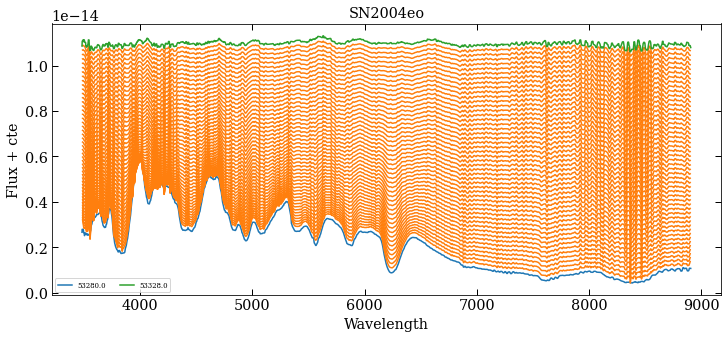

#########################################################################################################################
Interpolation between dates: 53280.0 53332.0
Interpolation between dates: 53280.0 53346.0
Interpolation between dates: 53280.0 53350.0
Interpolation between dates: 53285.0 53289.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53289.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53289.0 53286.0 0.25
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53289.0 53287.0 0.5
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53289.0 53288.0 0.75
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53289.0 53289.0 1.

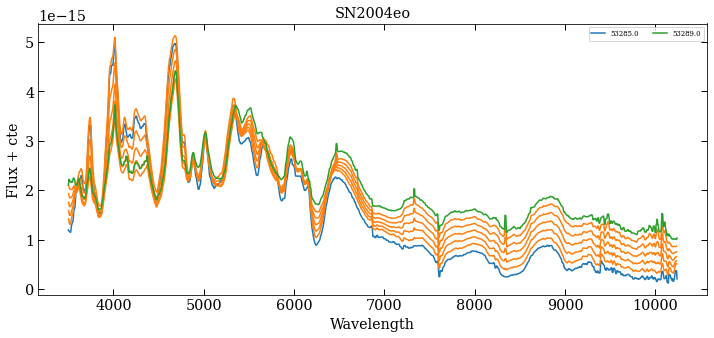

#########################################################################################################################
Interpolation between dates: 53285.0 53291.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.0 53286.0 0.16666666666666666
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.0 53287.0 0.3333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.0 53288.0 0.5
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.0 53289.0 0.6666666666666666
regularization term: 5e-07
--------------------------------------
Name | Ii

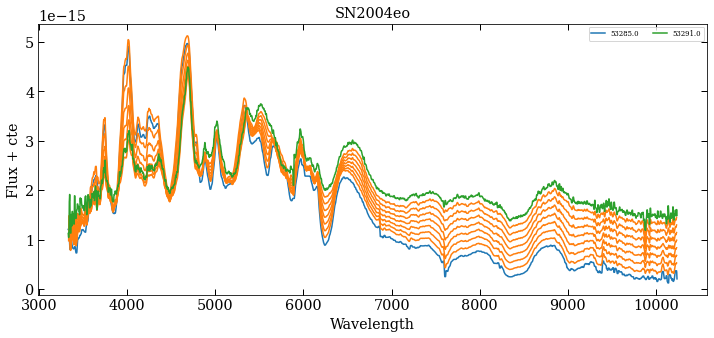

#########################################################################################################################
Interpolation between dates: 53285.0 53291.3
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.3 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.3 53286.0 0.1587301587300854
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.3 53287.0 0.3174603174601708
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.3 53288.0 0.47619047619025623
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53291.3 53289.0 0.6349206349203416
regularization term: 5e-07
--------------------------

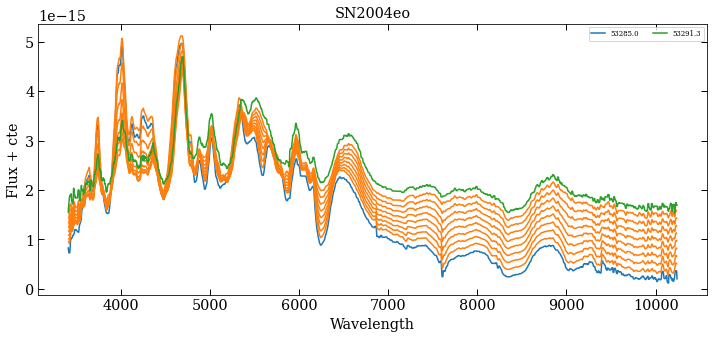

#########################################################################################################################
Interpolation between dates: 53285.0 53292.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53292.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53292.0 53286.0 0.14285714285714285
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53292.0 53287.0 0.2857142857142857
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53292.0 53288.0 0.42857142857142855
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53292.0 53289.0 0.5714285714285714
regularization term: 5e-07
-------------------------

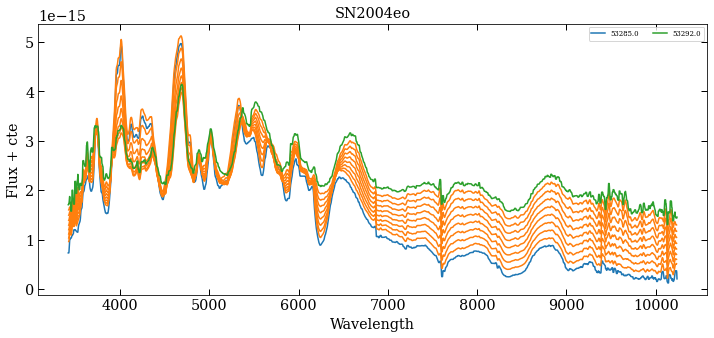

#########################################################################################################################
Interpolation between dates: 53285.0 53299.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53299.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53299.0 53286.0 0.07142857142857142
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53299.0 53287.0 0.14285714285714285
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53299.0 53288.0 0.21428571428571427
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53299.0 53289.0 0.2857142857142857
r

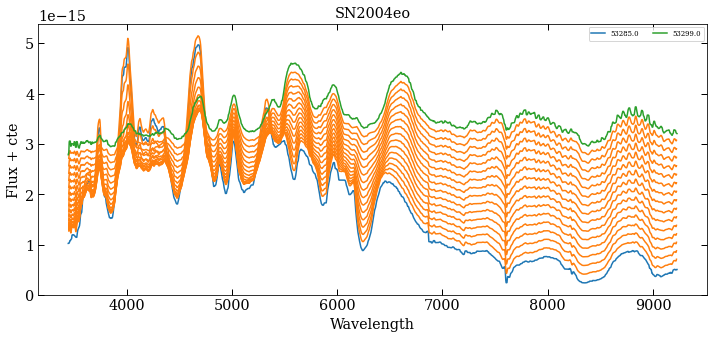

#########################################################################################################################
Interpolation between dates: 53285.0 53300.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53300.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53300.0 53286.0 0.06666666666666667
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53300.0 53287.0 0.13333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53300.0 53288.0 0.2
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53300.0 53289.0 0.26666666666666666
regulariz

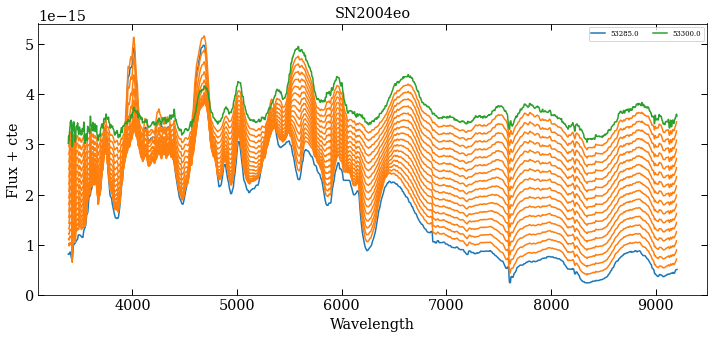

#########################################################################################################################
Interpolation between dates: 53285.0 53302.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53302.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53302.0 53286.0 0.058823529411764705
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53302.0 53287.0 0.11764705882352941
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53302.0 53288.0 0.17647058823529413
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53302.0 53289.

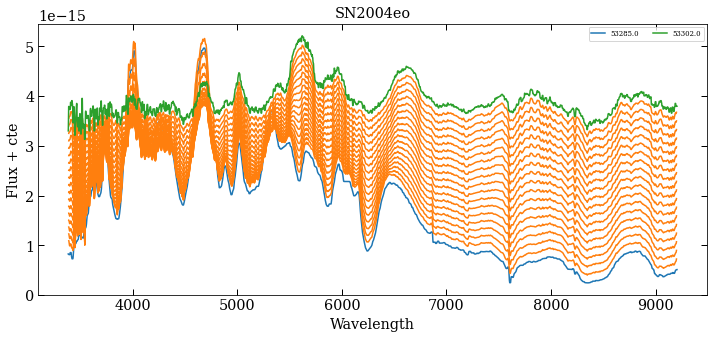

#########################################################################################################################
Interpolation between dates: 53285.0 53303.02
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53303.02 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53303.02 53286.0 0.05549389567148599
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53303.02 53287.0 0.11098779134297199
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53303.02 53288.0 0.16648168701445798
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 5328

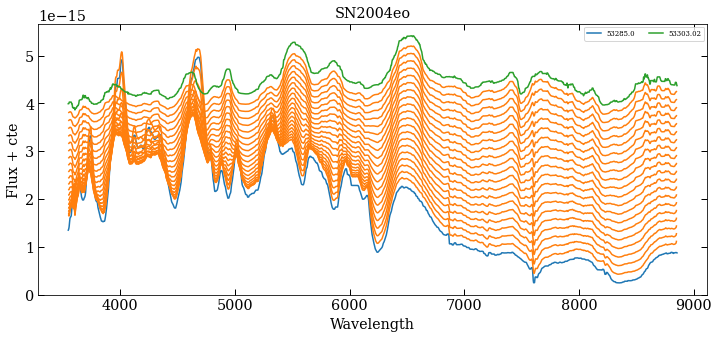

#########################################################################################################################
Interpolation between dates: 53285.0 53308.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53308.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53308.0 53286.0 0.043478260869565216
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53308.0 53287.0 0.08695652173913043
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53308.0 53288.0 0.13043478260869565
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | In

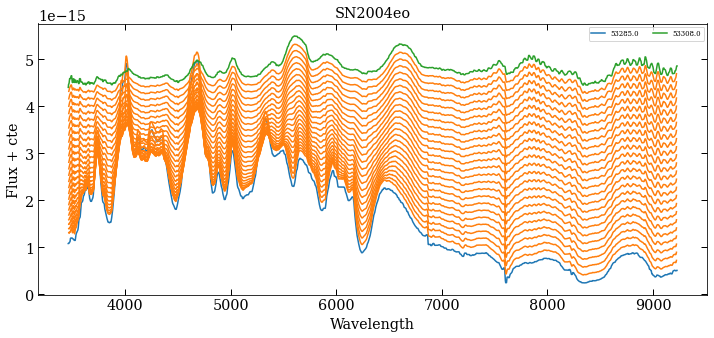

#########################################################################################################################
Interpolation between dates: 53285.0 53323.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308. 53309. 53310. 53311. 53312. 53313. 53314.
 53315. 53316. 53317. 53318. 53319. 53320. 53321. 53322. 53323.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53323.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53323.0 53286.0 0.02631578947368421
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53323.0 53287.0 0.05263157894736842
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53323.0 53288.0 0.0789

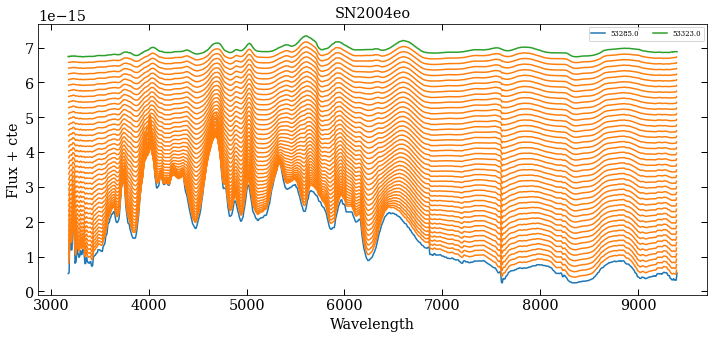

#########################################################################################################################
Interpolation between dates: 53285.0 53324.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308. 53309. 53310. 53311. 53312. 53313. 53314.
 53315. 53316. 53317. 53318. 53319. 53320. 53321. 53322. 53323. 53324.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53324.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53324.0 53286.0 0.02564102564102564
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53324.0 53287.0 0.05128205128205128
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53324.0 53288.0

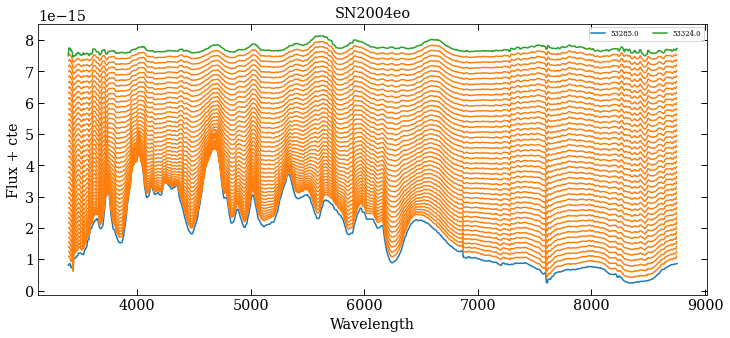

#########################################################################################################################
Interpolation between dates: 53285.0 53327.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308. 53309. 53310. 53311. 53312. 53313. 53314.
 53315. 53316. 53317. 53318. 53319. 53320. 53321. 53322. 53323. 53324.
 53325. 53326. 53327.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53327.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53327.0 53286.0 0.023809523809523808
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53327.0 53287.0 0.047619047619047616
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo

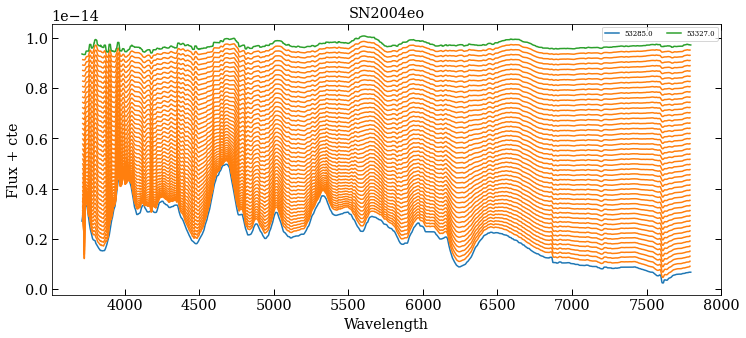

#########################################################################################################################
Interpolation between dates: 53285.0 53328.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308. 53309. 53310. 53311. 53312. 53313. 53314.
 53315. 53316. 53317. 53318. 53319. 53320. 53321. 53322. 53323. 53324.
 53325. 53326. 53327. 53328.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53328.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53328.0 53286.0 0.023255813953488372
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53328.0 53287.0 0.046511627906976744
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
S

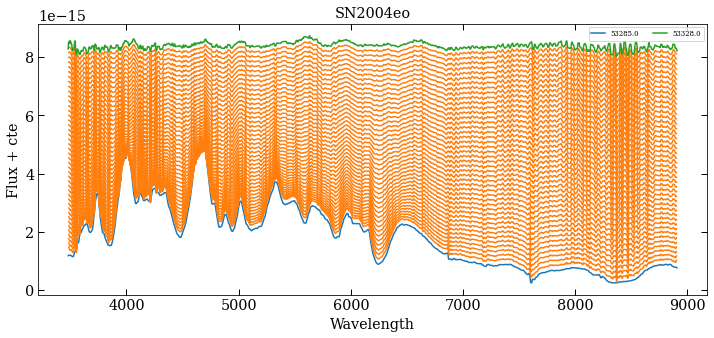

#########################################################################################################################
Interpolation between dates: 53285.0 53332.0
Producing grid with dates: [53285. 53286. 53287. 53288. 53289. 53290. 53291. 53292. 53293. 53294.
 53295. 53296. 53297. 53298. 53299. 53300. 53301. 53302. 53303. 53304.
 53305. 53306. 53307. 53308. 53309. 53310. 53311. 53312. 53313. 53314.
 53315. 53316. 53317. 53318. 53319. 53320. 53321. 53322. 53323. 53324.
 53325. 53326. 53327. 53328. 53329. 53330. 53331. 53332.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53332.0 53285.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53332.0 53286.0 0.02127659574468085
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53285.0 53332.0 53287.0 0.0425531914893617
regularization term: 5e-07
--------------------------------------
Name | Iinici

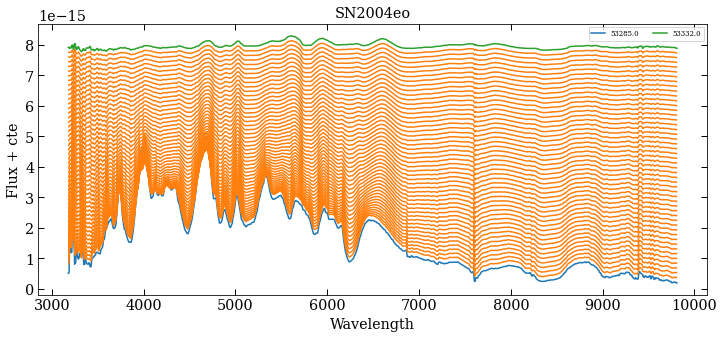

#########################################################################################################################
Interpolation between dates: 53285.0 53346.0
Interpolation between dates: 53285.0 53350.0
Interpolation between dates: 53289.0 53291.0
Producing grid with dates: [53289. 53290. 53291.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53291.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53291.0 53290.0 0.5
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53291.0 53291.0 1.0
regularization term: 5e-07
--------------------------------------


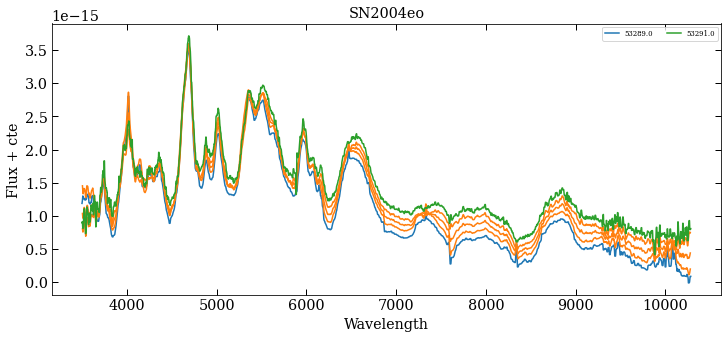

#########################################################################################################################
Interpolation between dates: 53289.0 53291.3
Producing grid with dates: [53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53291.3 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53291.3 53290.0 0.434782608695102
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53291.3 53291.0 0.869565217390204
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53291.3 53292.0 1.304347826085306
regularization term: 5e-07
--------------------------------------


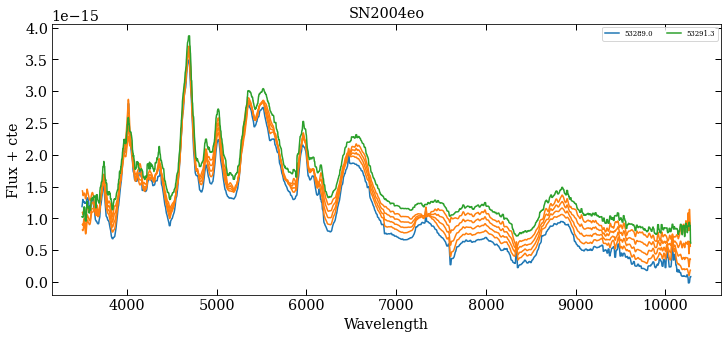

#########################################################################################################################
Interpolation between dates: 53289.0 53292.0
Producing grid with dates: [53289. 53290. 53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53292.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53292.0 53290.0 0.3333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53292.0 53291.0 0.6666666666666666
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53292.0 53292.0 1.0
regularization term: 5e-07
--------------------------------------


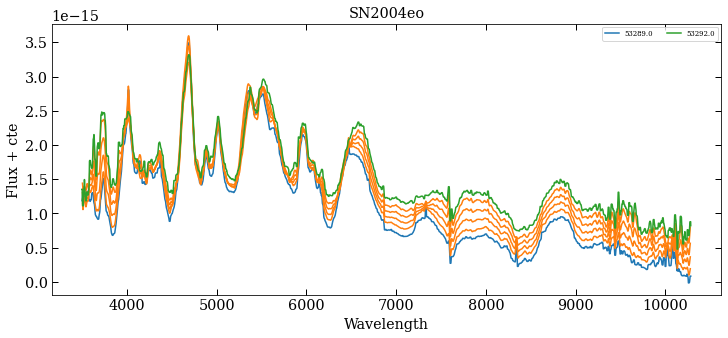

#########################################################################################################################
Interpolation between dates: 53289.0 53299.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53299.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53299.0 53290.0 0.1
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53299.0 53291.0 0.2
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53299.0 53292.0 0.3
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53299.0 53293.0 0.4
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Int

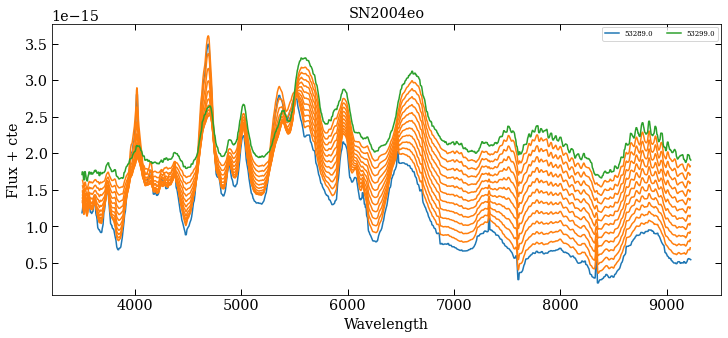

#########################################################################################################################
Interpolation between dates: 53289.0 53300.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53300.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53300.0 53290.0 0.09090909090909091
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53300.0 53291.0 0.18181818181818182
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53300.0 53292.0 0.2727272727272727
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53300.0 53293.0 0.36363636363636365
regularization term: 5

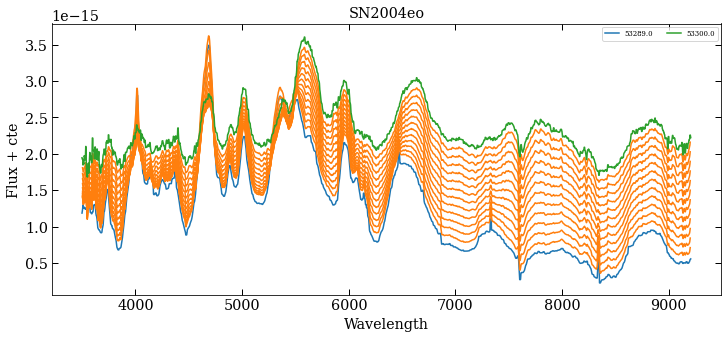

#########################################################################################################################
Interpolation between dates: 53289.0 53302.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53302.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53302.0 53290.0 0.07692307692307693
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53302.0 53291.0 0.15384615384615385
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53302.0 53292.0 0.23076923076923078
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53302.0 53293.0 0.3076923076923077
regulari

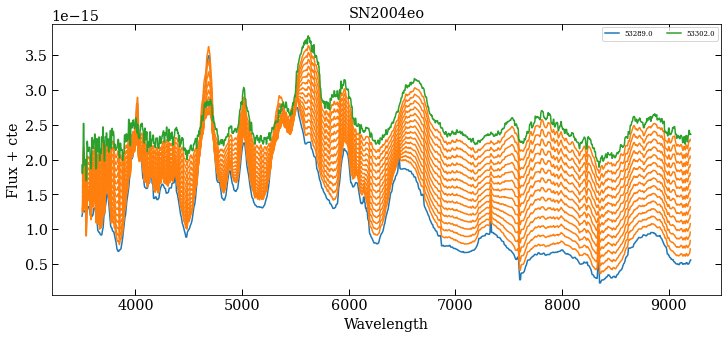

#########################################################################################################################
Interpolation between dates: 53289.0 53303.02
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53303.02 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53303.02 53290.0 0.07132667617690644
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53303.02 53291.0 0.14265335235381288
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53303.02 53292.0 0.21398002853071935
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53303.02 53293.0 0.28530

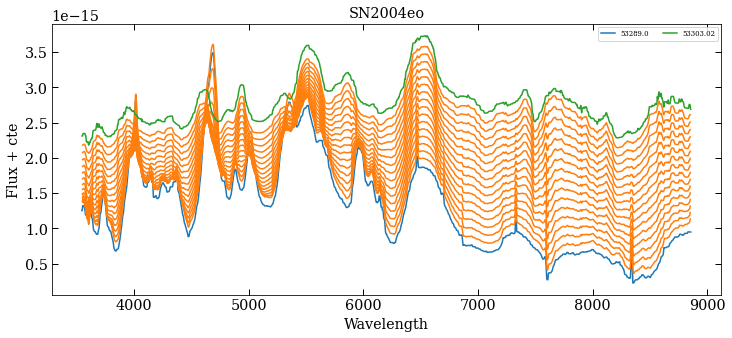

#########################################################################################################################
Interpolation between dates: 53289.0 53308.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53308.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53308.0 53290.0 0.05263157894736842
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53308.0 53291.0 0.10526315789473684
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53308.0 53292.0 0.15789473684210525
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 5

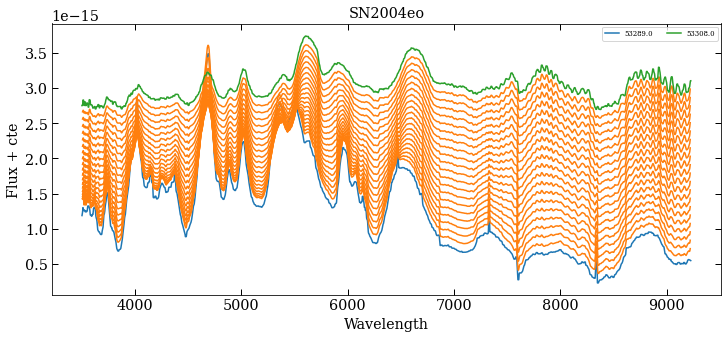

#########################################################################################################################
Interpolation between dates: 53289.0 53323.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.
 53309. 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318.
 53319. 53320. 53321. 53322. 53323.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53323.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53323.0 53290.0 0.029411764705882353
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53323.0 53291.0 0.058823529411764705
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53323.0 53292.0 0.08823529411764706
regularizati

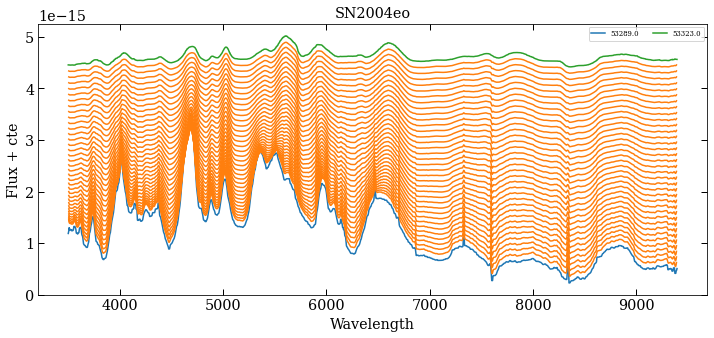

#########################################################################################################################
Interpolation between dates: 53289.0 53324.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.
 53309. 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318.
 53319. 53320. 53321. 53322. 53323. 53324.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53324.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53324.0 53290.0 0.02857142857142857
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53324.0 53291.0 0.05714285714285714
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53324.0 53292.0 0.08571428571428572
regular

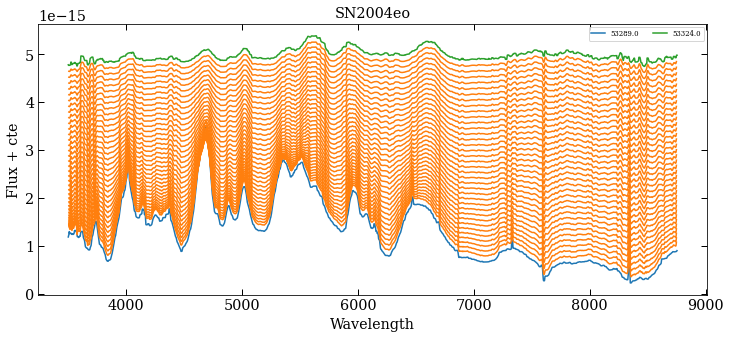

#########################################################################################################################
Interpolation between dates: 53289.0 53327.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.
 53309. 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318.
 53319. 53320. 53321. 53322. 53323. 53324. 53325. 53326. 53327.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53327.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53327.0 53290.0 0.02631578947368421
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53327.0 53291.0 0.05263157894736842
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53327.0 53292.0 0.0789

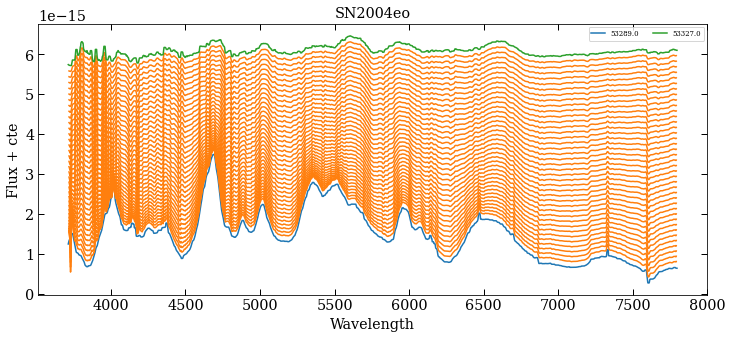

#########################################################################################################################
Interpolation between dates: 53289.0 53328.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.
 53309. 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318.
 53319. 53320. 53321. 53322. 53323. 53324. 53325. 53326. 53327. 53328.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53328.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53328.0 53290.0 0.02564102564102564
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53328.0 53291.0 0.05128205128205128
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53328.0 53292.0

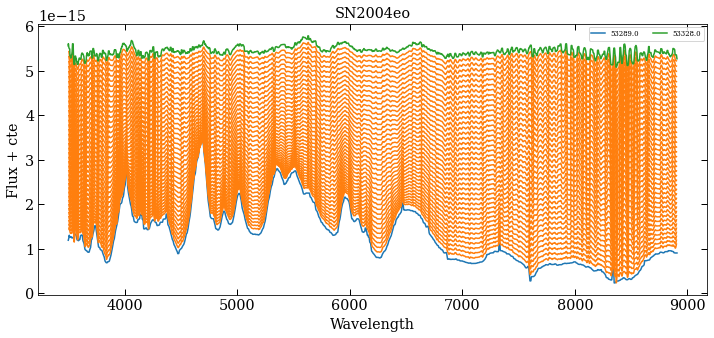

#########################################################################################################################
Interpolation between dates: 53289.0 53332.0
Producing grid with dates: [53289. 53290. 53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298.
 53299. 53300. 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.
 53309. 53310. 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318.
 53319. 53320. 53321. 53322. 53323. 53324. 53325. 53326. 53327. 53328.
 53329. 53330. 53331. 53332.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53332.0 53289.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53332.0 53290.0 0.023255813953488372
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53289.0 53332.0 53291.0 0.046511627906976744
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
S

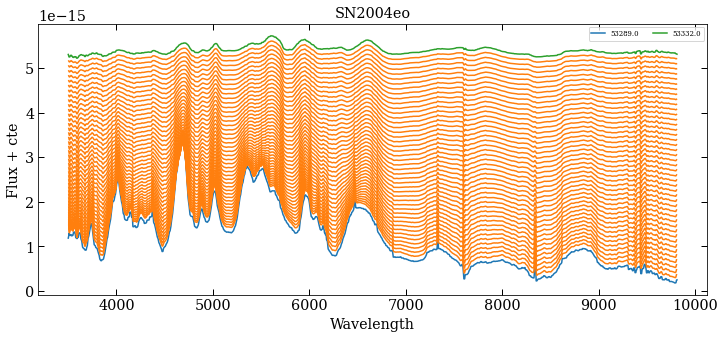

#########################################################################################################################
Interpolation between dates: 53289.0 53346.0
Interpolation between dates: 53289.0 53350.0
Interpolation between dates: 53291.0 53291.3
Producing grid with dates: [53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53291.3 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53291.3 53292.0 3.333333333300996
regularization term: 5e-07
--------------------------------------


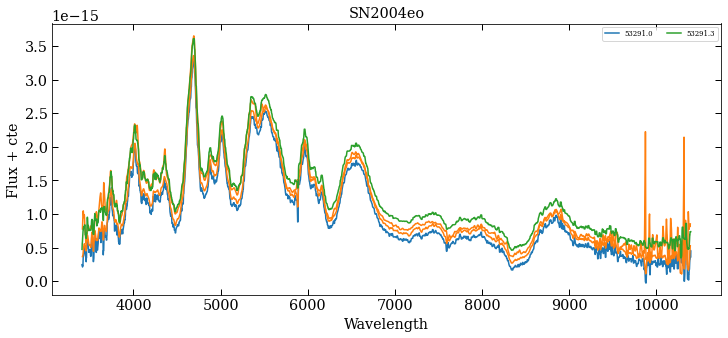

#########################################################################################################################
Interpolation between dates: 53291.0 53292.0
Producing grid with dates: [53291. 53292.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53292.0 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53292.0 53292.0 1.0
regularization term: 5e-07
--------------------------------------


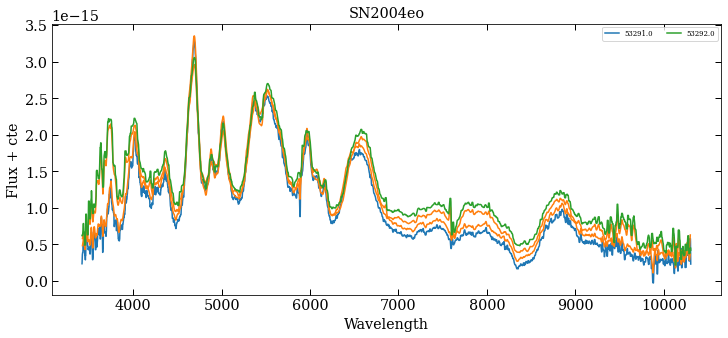

#########################################################################################################################
Interpolation between dates: 53291.0 53299.0
Producing grid with dates: [53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53299.0 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53299.0 53292.0 0.125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53299.0 53293.0 0.25
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53299.0 53294.0 0.375
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53299.0 53295.0 0.5
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha

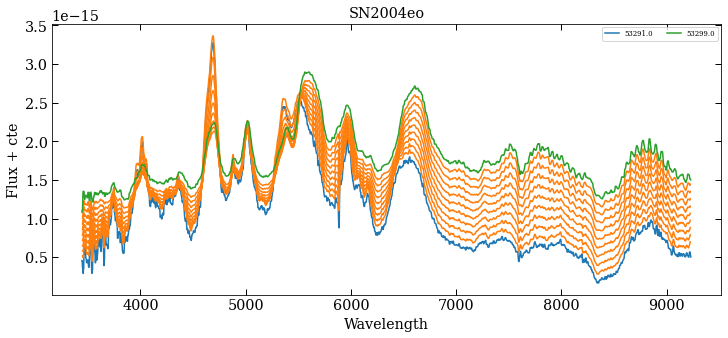

#########################################################################################################################
Interpolation between dates: 53291.0 53300.0
Producing grid with dates: [53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53300.0 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53300.0 53292.0 0.1111111111111111
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53300.0 53293.0 0.2222222222222222
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53300.0 53294.0 0.3333333333333333
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53300.0 53295.0 0.4444444444444444
regularization term: 5e-07
-------------

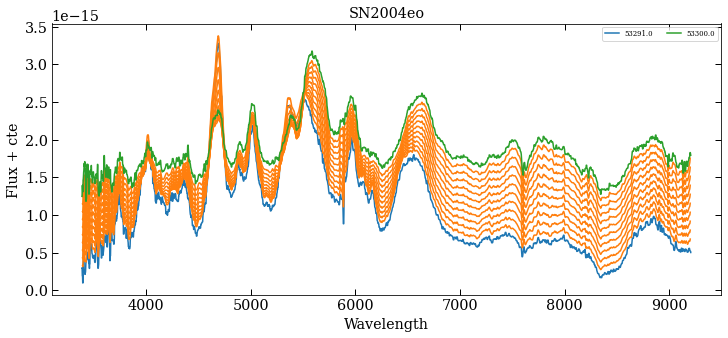

#########################################################################################################################
Interpolation between dates: 53291.0 53302.0
Producing grid with dates: [53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300.
 53301. 53302.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53302.0 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53302.0 53292.0 0.09090909090909091
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53302.0 53293.0 0.18181818181818182
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53302.0 53294.0 0.2727272727272727
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53302.0 53295.0 0.36363636363636365
regularization term: 5

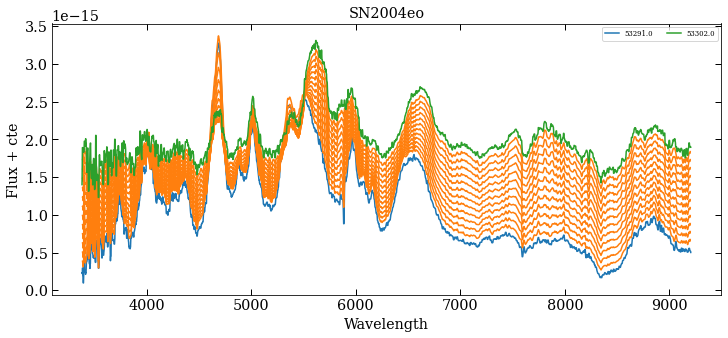

#########################################################################################################################
Interpolation between dates: 53291.0 53303.02
Producing grid with dates: [53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300.
 53301. 53302. 53303. 53304.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53303.02 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53303.02 53292.0 0.08319467554078755
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53303.02 53293.0 0.1663893510815751
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53303.02 53294.0 0.24958402662236265
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53303.02 53295.0 0.3327787021631502
reg

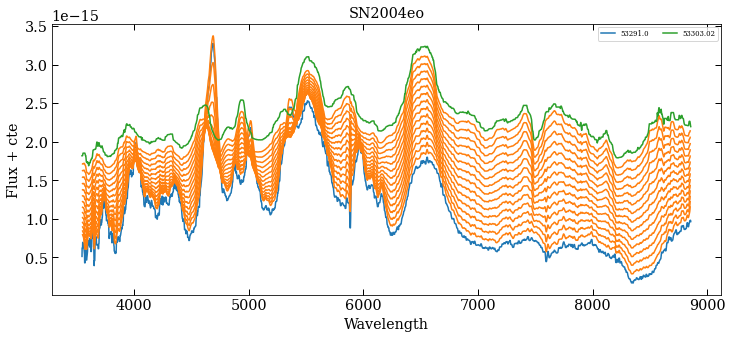

#########################################################################################################################
Interpolation between dates: 53291.0 53308.0
Producing grid with dates: [53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300.
 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53308.0 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53308.0 53292.0 0.058823529411764705
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53308.0 53293.0 0.11764705882352941
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53308.0 53294.0 0.17647058823529413
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53308.0 53295.

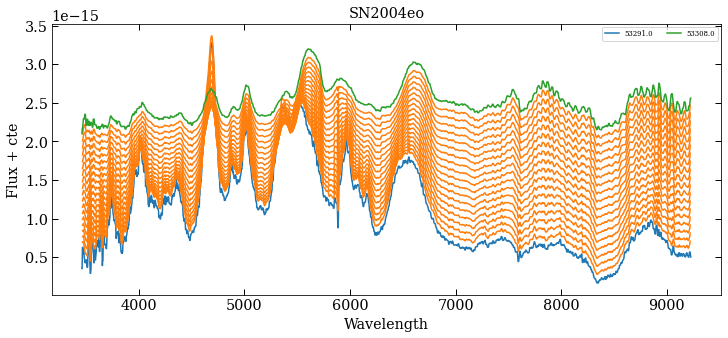

#########################################################################################################################
Interpolation between dates: 53291.0 53323.0
Producing grid with dates: [53291. 53292. 53293. 53294. 53295. 53296. 53297. 53298. 53299. 53300.
 53301. 53302. 53303. 53304. 53305. 53306. 53307. 53308. 53309. 53310.
 53311. 53312. 53313. 53314. 53315. 53316. 53317. 53318. 53319. 53320.
 53321. 53322. 53323.]
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53323.0 53291.0 0.0
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53323.0 53292.0 0.03125
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53323.0 53293.0 0.0625
regularization term: 5e-07
--------------------------------------
Name | Iinicio | Fin | Inter | Alpha
SN2004eo 53291.0 53323.0 53294.0 0.09375
regularization term: 5e-07
--------------------------------------

In [ ]:
#%%capture
import warnings

warnings.filterwarnings('ignore', category=RuntimeWarning)
warnings.filterwarnings('ignore', category=UserWarning)



from time import time

start_time = time()
# Create output directories
try:
    os.mkdir(os.path.join(os.getcwd(),"Data","OT_uncalibrated_1"))
except FileExistsError:
    pass
try:
    os.mkdir(os.path.join(os.getcwd(),"Data","OT_uncalibrated_1_plot"))
except FileExistsError:
    pass

#lista_=['SN2005az_spectra.dat', 'SN2004gq_spectra.dat', 'SN2004gk_spectra.dat', 'SN2004dk_spectra.dat',
# 'SN2004fe_spectra.dat', 'SN2004aw_spectra.dat', 'SN2004ao_spectra.dat', 'SN1999ex_spectra.dat',
# 'SN1994I_spectra.dat', 'SN1990B_spectra.dat', 'SN1990I_spectra.dat', 'SN2005hg_spectra.dat']

for elemento in grupos[9]:
    process_supernova(elemento) #just one SN

elapsed_time = time() - start_time
print("Elapsed time: %.1f seconds." % elapsed_time)

In [ ]:
elemento

'SN2004gt_spectra.dat'